### 2. actual comparison of glacier changes to climate changes 

- takes regional glacier climate changes as input and global or regional glacier-area weighted temp. changes 

- todo: at the moment, I look at yr. 2000 (as all simulations go until then),
    - if I look into yr 5000, need to do decide what we do with the scenarios that only run until 2000
- todo: move the old test plots and temporal projection files into another notebook!!!


---

In [1]:
DATE = 'MAY16' #'apr04' (has OGGM runaway effect of glaciers inside)
# download it here https://cluster.klima.uni-bremen.de/~lschuster/glacierMIP3_analysis/glacierMIP3_mar14_models_all_rgi_regions_sum_scaled.nc
# and change the path to your local path
path_merged_runs_scaled = f'/home/www/lschuster/glacierMIP3_analysis/glacierMIP3_{DATE}_models_all_rgi_regions_sum_scaled.nc'
fill_option = 'repeat_last_20yrs'
path_merged_runs_scaled_extend = f'/home/www/lschuster/glacierMIP3_analysis/glacierMIP3_{DATE}_models_all_rgi_regions_sum_scaled_extended_{fill_option}.nc'

---

In [2]:
import xarray as xr
import numpy as np
import pandas as pd
import os
import glob
import seaborn as sns
import matplotlib.pyplot as plt
from help_func import pal_models, model_order, d_reg_num_name

dict_model_color = {}
for c,m in zip(pal_models, model_order):
    dict_model_color[m] = c

In [3]:
model_authors = ['James', 'Rounce', 'Compagno', 'Kraaijenbrink', 'GLIMB', #'OGGM_v153',
                 'OGGM_v16', 'OGGM-VAS', 'Zekollari'#, 'Huss'
                ]

In [4]:
pd_global_temp_exp = pd.read_csv('../data/temp_ch_ipcc_isimip3b.csv', index_col = 0)

ds_reg_models = xr.open_dataset(path_merged_runs_scaled_extend)
ds_reg_models = ds_reg_models.reset_coords()
# add temp. coordinate
ds_dummy = ds_reg_models.isel(rgi_reg=0).load().copy(deep=True)
ds_dummy['volume_m3'].data[...] = ds_reg_models.volume_m3.sum(dim='rgi_reg')
ds_dummy['area_m2'].data[...] = ds_reg_models.area_m2.sum(dim='rgi_reg')
ds_dummy = ds_dummy.drop('rgi_reg')
#ds_dummy = ds_dummy.expand_dims({'rgi_reg':['All']}).transpose()
ds_dummy = ds_dummy.expand_dims({'rgi_reg':['GMT', 'All']}).transpose()
ds_reg_models = xr.concat([ds_reg_models, ds_dummy], dim='rgi_reg')
ds_reg_models.coords['deltaT (IPCC)'] =pd_global_temp_exp.groupby(['gcm','period_scenario']).mean().to_xarray()['temp_ch_ipcc']
ds_reg_models = ds_reg_models.reset_coords()
# we removed Huss from the list anyways, so this could be removed ... 
assert np.all(np.isnan(ds_reg_models.sel(model_author='Huss').sel(gcm='ukesm1-0-ll').sel(rgi_reg='01').volume_m3))

pd_init_vol=ds_reg_models.volume_m3.sel(simulation_year=0,model_author='GLIMB').max(dim=['gcm', 'period_scenario']).to_dataframe()
rgi_num_order = pd_init_vol['volume_m3'].sort_values(ascending=False).index.drop('GMT')

ds_reg_models = ds_reg_models.sel(model_author=model_authors) 

In [5]:
ds_reg_models.gcm

<xarray.DataArray 'gcm' (gcm: 5)>
array(['gfdl-esm4', 'ipsl-cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0',
       'ukesm1-0-ll'], dtype=object)
Coordinates:
  * gcm      (gcm) object 'gfdl-esm4' 'ipsl-cm6a-lr' ... 'ukesm1-0-ll'

[15830.025   12436.951   15693.351    9350.725    7292.7754   7819.954
  6635.973    8086.898    6673.164    5211.896    8567.341    4670.992
  4801.5586   6788.7573   3186.6057   2741.0044  18077.74    20968.715
 15744.143    8780.71     7688.374    8921.53     5989.27     5834.7812
  5048.6074   4412.3867   4548.0586   2175.6777   1829.3536   4831.4263
  1021.6472    361.7903  18693.848   18315.906   20473.852   14125.762
  9379.597    8273.842    8689.155   12985.686    6958.94     7118.5776
  9088.27     5354.505    5083.9985   7408.5083   5099.0913   4853.169
 17248.75    15897.838   14744.859    9845.626    4128.0864   5292.034
  6375.4146   5293.9033   3236.5073   2497.487    7466.217    1990.4128
  1369.5135   6849.1714    741.89435   549.7425          nan         nan
         nan         nan         nan         nan         nan         nan
         nan         nan         nan         nan         nan         nan
         nan         nan] Compagno 05 2000
[15998.122   11881.935  

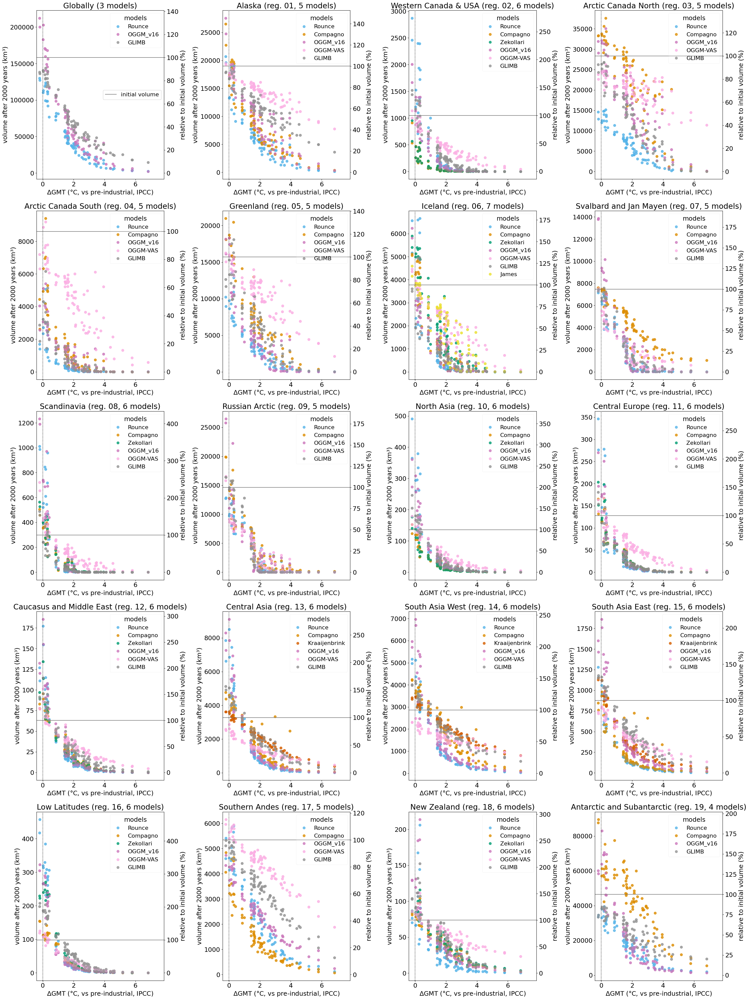

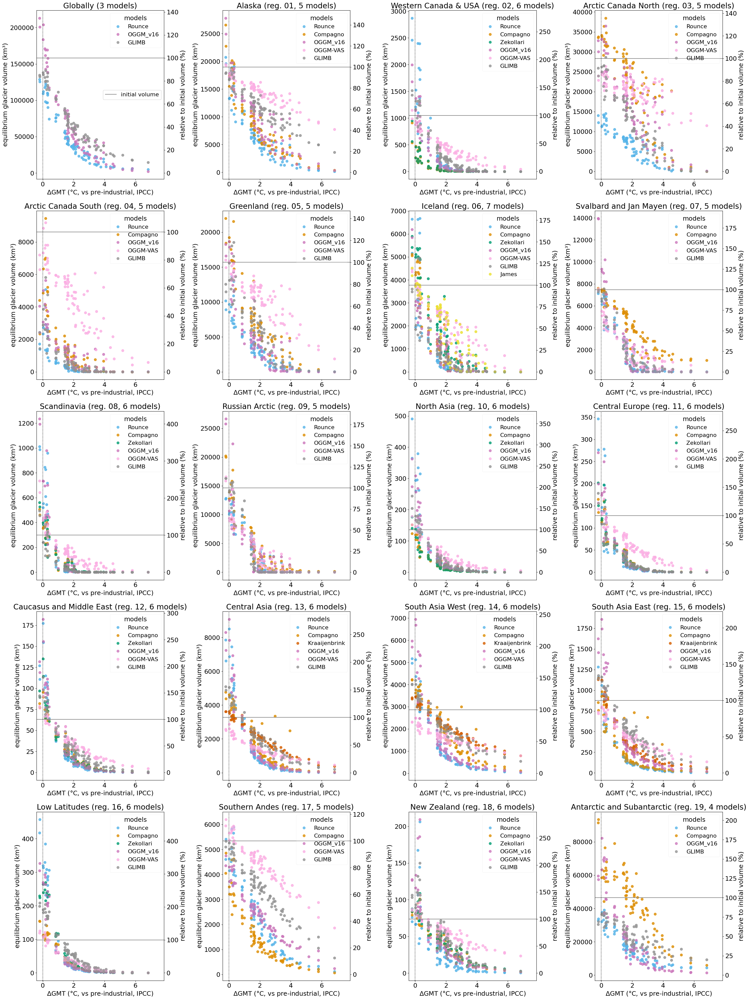

In [6]:
pd_reg_models_count = ds_reg_models.volume_m3.sel(simulation_year=0).to_dataframe().groupby(['rgi_reg', 'model_author'])['volume_m3'].count().reset_index()
pd_reg_models_count = pd_reg_models_count.loc[pd_reg_models_count.rgi_reg !='All']
pd_reg_models_count = pd_reg_models_count.rename(columns={'volume_m3':'n_experiments'})
# models available for each region...
_regional_model = pd_reg_models_count.loc[pd_reg_models_count.n_experiments > 0 ] # ==80

## amount of models per region
reg_n_models = pd_reg_models_count.loc[pd_reg_models_count.n_experiments > 0].groupby('rgi_reg').count()['model_author'] # at least 1 experiment for that RGI region
# models that are globally available 
global_models = pd_reg_models_count.groupby('model_author').sum().where(pd_reg_models_count.groupby('model_author').sum() == 80 * 20).dropna().index


plt.rcParams.update({'font.size': 18})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']
label_type = 'authors'
for sim_year in [2000, 'equilibrium']: #,1999]:
    fig, axs = plt.subplots(5,4,figsize=(30,40)) #, sharey='row') #, sharex=True)
    rgi_regs_global = rgi_num_order
    rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
           '13', '14', '15', '16', '17', '18', '19']
    for j, rgi_reg in enumerate(rgi_regs_global):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]
        if rgi_reg == 'All':
            # only take models that exist globally
            # at the moment Rounce and Glimb, OGGM
            n = len(global_models)
            mj = 0
            for c,m in zip(pal_models, model_order):
                if m in global_models:
                    mj+=1
                    if label_type == 'anonymous':
                        label = f'model {mj}'
                    else:
                        label = m
                    if sim_year == 'equilibrium':
                        y = ds_reg_models.volume_m3.sel(simulation_year=slice(4981,5000),
                                                        model_author=m, rgi_reg=rgi_reg).mean(dim='simulation_year').values.flatten()/1e9
                    else:
                        y = ds_reg_models.volume_m3.sel(simulation_year=sim_year,
                                                    model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9
                    if np.any(np.isnan(y)):
                        print(y, m, rgi_reg, sim_year)
                    ax.plot(ds_reg_models['deltaT (IPCC)'].values.flatten(), # delta T to median GCM
                         y,
                         marker='o',markersize=7, lw=0, color=c, label = label, alpha = 0.8)  # instead of m
                else:
                    pass

        else:    
            models_available = _regional_model.loc[_regional_model.rgi_reg==rgi_reg]['model_author'].values
            n = reg_n_models[rgi_reg]
            mj=0
            for c,m in zip(pal_models, model_order):
                if m in models_available:
                    mj+=1
                    if label_type == 'anonymous':
                        label = f'model {mj}'
                    else:
                        label = m
                    if sim_year == 'equilibrium':
                        y = ds_reg_models.volume_m3.sel(simulation_year=slice(4981,5000),
                                                        model_author=m, rgi_reg=rgi_reg).mean(dim='simulation_year').values.flatten()/1e9
                    else:
                        y = ds_reg_models.volume_m3.sel(simulation_year=sim_year,
                                                    model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9
                    if np.any(np.isnan(y)):
                        print(y, m, rgi_reg, sim_year)
                    ax.plot(ds_reg_models['deltaT (IPCC)'].values.flatten(), # .sel(rgi_reg='GMT')
                             y,
                             marker='o',markersize=7, lw=0, color=c, label = label, alpha = 0.8)  # instead of m

        handles, labels = ax.get_legend_handles_labels()
        #if j == 0 or j ==1:
        leg1 = ax.legend(handles, labels, title ='models', fontsize=16, framealpha=0.2, loc='upper right')
        #for c,m in zip(pal_models, ds_reg_models.model_author):
        # if I use max does not matter, I just do not 
        ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max()/1e9, color='grey', label='initial volume') # , loc='upper right')
            #ax.axhspan(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).min()/1e9,
        #                ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).max()/1e9, alpha =0.1, color =c, label='min_max')
        handles, labels = ax.get_legend_handles_labels()
        if j == 0:
            if sim_year == 'equilibrium': #3000:
                loc = 'center left'
                boxi = (0,0.4)
            else:
                loc = 'center right'
                boxi = (1,0.4)
            
            if rgi_reg == 'All':
                ax.legend([handles[-1]], ['initial volume'], loc ='center right', fontsize=16) #, bbox_to_anchor=boxi)
            else:
                ax.legend([handles[-1]], ['initial volume'], loc =loc, bbox_to_anchor=boxi, fontsize=16)

            ax.add_artist(leg1)
        #leg1.remove():
        if sim_year == 'equilibrium':
            ax.set_ylabel(f'{sim_year} glacier volume (km³)')
        else:
            ax.set_ylabel(f'volume after {sim_year} years (km³)')

        ax.set_xlabel(f'$\Delta$GMT (°C, vs pre-industrial, IPCC)') # actually now: vs median global GCM 1850-1900  ... before vs median global GCM 1995-2014
        med_initial_vol = ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max().values/1e9
        initial_vol = f'median: {med_initial_vol:.2f}km3'
        if rgi_reg != 'All':
            nam = d_reg_num_name[rgi_reg]
            ax.set_title(f'{nam} (reg. {rgi_reg}, {n} models)')
        else:
            ax.set_title(f'Globally ({n} models)')
        ax.axvline(0, ls=':', color='k')
        
        #def func_vol_to_rel_vol(x):
        #    return x*100/(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max().values/1e9)

        #def func_rel_vol_to_vol(x):
        #    return x*(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max().values/1e9) / 100
        #secax = ax.secondary_yaxis('right', functions=(func_vol_to_rel_vol,
        #                                               func_rel_vol_to_vol))
        
        ax.set_xlim([ds_reg_models['deltaT (IPCC)'].min().values*2, ds_reg_models['deltaT (IPCC)'].max().values*1.15])
        ax2 = ax.twinx()
        
        if rgi_reg == 'All':
            # only take models that exist globally
            # at the moment Rounce and Glimb, Compagno
            n = len(global_models)
            for c,m in zip(pal_models, model_order):
                if m in global_models:
                    if sim_year == 'equilibrium':
                        y_rel = 100*ds_reg_models.volume_m3.sel(simulation_year=slice(4981,5000),
                                                        model_author=m, rgi_reg=rgi_reg).mean(dim='simulation_year').values.flatten()/1e9/med_initial_vol
                    else:
                        y_rel = 100*ds_reg_models.volume_m3.sel(simulation_year=sim_year,
                                                    model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9/med_initial_vol
                    ax2.plot(ds_reg_models['deltaT (IPCC)'].values.flatten(),
                         y_rel,
                         marker='o',markersize=7, lw=0, color=c, label = m, #instead of m
                             alpha=0.1)
                else:
                    pass

        else:    
            models_available = _regional_model.loc[_regional_model.rgi_reg==rgi_reg]['model_author'].values
            n = reg_n_models[rgi_reg]

            for c,m in zip(pal_models, model_order):
                if m in models_available:
                    if sim_year == 'equilibrium':
                        y_rel = 100*ds_reg_models.volume_m3.sel(simulation_year=slice(4981,5000),
                                                        model_author=m, rgi_reg=rgi_reg).mean(dim='simulation_year').values.flatten()/1e9/med_initial_vol
                    else:
                        y_rel = 100*ds_reg_models.volume_m3.sel(simulation_year=sim_year,
                                                    model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9/med_initial_vol
                    ax2.plot(ds_reg_models['deltaT (IPCC)'].values.flatten(),
                         y_rel,
                         marker='o',markersize=7, lw=0, color=c, label = m, #instead of m
                             alpha=0.1)
        ax2.set_ylabel('relative to initial volume (%)')
        
        #scaler = 1e7 * med_initial_vol
        #ax2.set_ylim([-2,450])
        #ax.set_ylim([-2*scaler,450*scaler])

        #ax2.set_ylim([0,400])
        #ax2.plot(100, color='grey') # , label='initial volume')
        #ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max()/1e9, color='grey')
    #plt.grid()
    plt.tight_layout()
    
    plt.savefig(f'figures/2_GlacierMIP3_regional_glacier_{sim_year}yrs_vs_GMT_change_IPCC_{DATE}.png') # path_analysis + 

In [7]:
ds_reg_models['deltaT (IPCC)'].min().values*2, ds_reg_models['deltaT (IPCC)'].max().values*1.15

(-0.4070575502625482, 7.848015177053622)

### Against glacier (regional) temperature change ...

In [9]:
pd_glac_reg_temp_exp = pd.read_csv('../data/temp_ch_ipcc_isimip3b_glacier_regionally.csv', index_col = 0)
ds_reg_models.coords['deltaT (IPCC) special'] = pd_glac_reg_temp_exp.groupby(['gcm','period_scenario', 'region']).mean().to_xarray()['temp_ch_ipcc']# .sel(region='')
ds_reg_models = ds_reg_models.reset_coords()

In [ ]:
pd_reg_models_count = ds_reg_models.volume_m3.sel(simulation_year=0).to_dataframe().groupby(['rgi_reg', 'model_author'])['volume_m3'].count().reset_index()
pd_reg_models_count = pd_reg_models_count.loc[pd_reg_models_count.rgi_reg !='All']
pd_reg_models_count = pd_reg_models_count.rename(columns={'volume_m3':'n_experiments'})
# models available for each region...
_regional_model = pd_reg_models_count.loc[pd_reg_models_count.n_experiments > 0 ] # ==80

## amount of models per region
reg_n_models = pd_reg_models_count.loc[pd_reg_models_count.n_experiments > 0].groupby('rgi_reg').count()['model_author'] # at least 1 experiment for that RGI region
# models that are globally available 
global_models = pd_reg_models_count.groupby('model_author').sum().where(pd_reg_models_count.groupby('model_author').sum() == 80 * 20).dropna().index

plt.rcParams.update({'font.size': 18})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']
label_type = 'authors'
for sim_year in [2000, 'equilibrium']: #,1999]:
    fig, axs = plt.subplots(5,4,figsize=(30,40)) #, sharey='row') #, sharex=True)
    rgi_regs_global = rgi_num_order
    rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19']
    for j, rgi_reg in enumerate(rgi_regs_global):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]
        
        if rgi_reg == 'All':
            # only take models that exist globally
            # at the moment Rounce and Glimb, Compagno
            region = 'global_glacier'
            n = len(global_models)
            mj = 0
            for c,m in zip(pal_models, model_order):
                if m in global_models:
                    mj+=1
                    if label_type == 'anonymous':
                        label = f'model {mj}'
                    else:
                        label = m
                    if sim_year == 'equilibrium':
                        y = ds_reg_models.volume_m3.sel(simulation_year=slice(4981,5000),
                                                        model_author=m, rgi_reg=rgi_reg).mean(dim='simulation_year').values.flatten()/1e9
                    else:
                        y = ds_reg_models.volume_m3.sel(simulation_year=sim_year,
                                                    model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9
                    ax.plot(ds_reg_models['deltaT (IPCC) special'].sel(region=region).values.flatten(), # delta T to median GCM
                            y,
                         marker='o',markersize=7, lw=0, color=c, label = label, alpha = 0.8)  # instead of m
                else:
                    pass

        else:
            region = f'RGI{rgi_reg}_glacier'
            models_available = _regional_model.loc[_regional_model.rgi_reg==rgi_reg]['model_author'].values
            n = reg_n_models[rgi_reg]
            mj=0
            for c,m in zip(pal_models, model_order):
                if m in models_available:
                    mj+=1
                    if label_type == 'anonymous':
                        label = f'model {mj}'
                    else:
                        label = m
                    if sim_year == 'equilibrium':
                        y = ds_reg_models.volume_m3.sel(simulation_year=slice(4981,5000),
                                                        model_author=m, rgi_reg=rgi_reg).mean(dim='simulation_year').values.flatten()/1e9
                    else:
                        y = ds_reg_models.volume_m3.sel(simulation_year=sim_year,
                                                    model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9
                    ax.plot(ds_reg_models['deltaT (IPCC) special'].sel(region=region).values.flatten(), # .sel(rgi_reg='GMT')
                            y,
                             marker='o',markersize=7, lw=0, color=c, label = label, alpha = 0.8)  # instead of m

        handles, labels = ax.get_legend_handles_labels()
        #if j == 0 or j ==1:
        leg1 = ax.legend(handles, labels, title ='models', fontsize=16, framealpha=0.2, loc='upper right')
        #for c,m in zip(pal_models, ds_reg_models.model_author):
        # if I use max does not matter, I just do not 
        ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max()/1e9, color='grey', label='initial volume') # , loc='upper right')
            #ax.axhspan(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).min()/1e9,
        #                ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).max()/1e9, alpha =0.1, color =c, label='min_max')
        handles, labels = ax.get_legend_handles_labels()
        if j == 0:
            if sim_year == 'equilibrium': #3000:
                loc = 'center left'
                boxi = (0,0.4)
            else:
                loc = 'center right'
                boxi = (1,0.4)
            if rgi_reg == 'All':
                ax.legend([handles[-1]], ['initial volume'], loc ='center right', fontsize=16) #, bbox_to_anchor=boxi)
            else:
                ax.legend([handles[-1]], ['initial volume'], loc =loc, bbox_to_anchor=boxi, fontsize=16)

            ax.add_artist(leg1)
        #leg1.remove()
        if sim_year == 'equilibrium':
            ax.set_ylabel(f'{sim_year} glacier volume (km³)')
        else:
            ax.set_ylabel(f'volume after {sim_year} years (km³)')
        
        ax.set_xlabel(f'$\Delta$T (regional glacier, °C, vs pre-industrial, IPCC)') # actually now: vs median global GCM 1850-1900  ... before vs median global GCM 1995-2014
        med_initial_vol = ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max().values/1e9
        initial_vol = f'median: {med_initial_vol:.2f}km3'
        if rgi_reg != 'All':
            nam = d_reg_num_name[rgi_reg]
            ax.set_title(f'{nam} (reg. {rgi_reg}, {n} models)')
        else:
            ax.set_title(f'Globally ({n} models)')
        ax.axvline(0, ls=':', color='k')
        
        #secax = ax.secondary_yaxis('right', functions=(func_vol_to_rel_vol,
        #                                               func_rel_vol_to_vol))
        ax2 = ax.twinx()
        
        if rgi_reg == 'All':
            # only take models that exist globally
            # at the moment Rounce and Glimb, Compagno
            region = 'global_glacier'
            n = len(global_models)
            for c,m in zip(pal_models, model_order):
                if m in global_models:
                    if sim_year == 'equilibrium':
                        y_rel = 100*ds_reg_models.volume_m3.sel(simulation_year=slice(4981,5000),
                                                        model_author=m, rgi_reg=rgi_reg).mean(dim='simulation_year').values.flatten()/1e9/med_initial_vol
                    else:
                        y_rel = 100*ds_reg_models.volume_m3.sel(simulation_year=sim_year,
                                                    model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9/med_initial_vol
                    ax2.plot(ds_reg_models['deltaT (IPCC) special'].sel(region=region).values.flatten(),
                             y_rel,
                         marker='o',markersize=7, lw=0, color=c, label = m, #instead of m
                             alpha=0.1)
                else:
                    pass

        else:    
            region = f'RGI{rgi_reg}_glacier'
            models_available = _regional_model.loc[_regional_model.rgi_reg==rgi_reg]['model_author'].values
            n = reg_n_models[rgi_reg]

            for c,m in zip(pal_models, model_order):
                if m in models_available:
                    if sim_year == 'equilibrium':
                        y_rel = 100*ds_reg_models.volume_m3.sel(simulation_year=slice(4981,5000),
                                                        model_author=m, rgi_reg=rgi_reg).mean(dim='simulation_year').values.flatten()/1e9/med_initial_vol
                    else:
                        y_rel = 100*ds_reg_models.volume_m3.sel(simulation_year=sim_year,
                                                    model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9/med_initial_vol
                    ax2.plot(ds_reg_models['deltaT (IPCC) special'].sel(region=region).values.flatten(),
                             y_rel,
                             marker='o',markersize=7, lw=0, color=c, label = m, # instead of m
                             alpha = 0.1)
        ax2.set_ylabel('relative to initial volume (%)')
        #ax2.set_ylim([0,400])
        #ax2.plot(100, color='grey') # , label='initial volume')
        #ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max()/1e9, color='grey')
    #plt.grid()
    plt.tight_layout()
    
    plt.savefig(f'figures/2_GlacierMIP3_regional_glacier_{sim_year}yrs_vs_regional_glacier_change_IPCC_{DATE}.png') # path_analysis + 

- todo: 
    - add a secondary y axis that roughly shows the delta GMT with uncertainty bars or so 

In [90]:
#plt.plot(ds_reg_models['deltaT (IPCC) special'].sel(region=region).values.flatten(), # .sel(rgi_reg='GMT')
#                             ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg)/1e9, 'o')

# OLD plots (need to check if some of them can be recycled)

### This uses the old method how to get regional glacier or global glacier temperature changes

In [2]:
# this is the absolute temperature difference compared to the reference time period together with the
# per degree global temperature warming temperature difference compared to the reference time period 
path_analysis = '/home/www/lschuster/glacierMIP3_analysis/'
#pd_temp_diff_1995_2014 = pd.read_csv(path_analysis + 'rgi_reg_glacier_area_weighted_temperature_difference_vs_1995_2014_isimip3b.csv',
#                                     index_col= [0])
pd_temp_diff_1850_1900 = pd.read_csv(path_analysis + 'rgi_reg_glacier_area_weighted_temperature_difference_vs_1850_1900_isimip3b.csv',
                                     index_col= [0])
# global avg. temp. 13.5?
#pd_prcp_change_1995_2014 = pd.read_csv(path_analysis + 'rgi_reg_glacier_area_weighted_prcp_change_vs_1995_2014_isimip3b.csv',
#                                      index_col=[0])

pd_prcp_change_1850_1900 = pd.read_csv(path_analysis + 'rgi_reg_glacier_area_weighted_prcp_change_vs_1850_1900_isimip3b.csv',
                                      index_col=[0])

In [4]:
pd_temp_diff_1850_1900

,rgi_reg,gcm,deltaT to same GCM,deltaT per deltaGMT to same GCM,deltaT to median GCM,ssp,period,ref_time
0,01,gfdl-esm4,-0.194977,4.263073,0.047629,hist,1851-1870,1850-1900
1,01,ipsl-cm6a-lr,0.133862,2.866323,-0.346073,hist,1851-1870,1850-1900
2,01,mpi-esm1-2-hr,0.206842,33.342171,0.156768,hist,1851-1870,1850-1900
3,01,mri-esm2-0,-0.047110,3.057710,-0.196232,hist,1851-1870,1850-1900
4,01,ukesm1-0-ll,0.221198,33.890158,0.641188,hist,1851-1870,1850-1900
...,...,...,...,...,...,...,...,...
2635,GMT_mean_diff,gfdl-esm4,3.724310,3.724310,3.810978,ssp585,2081-2100,1850-1900
2636,GMT_mean_diff,ipsl-cm6a-lr,6.027920,6.027920,5.671523,ssp585,2081-2100,1850-1900
2637,GMT_mean_diff,mpi-esm1-2-hr,3.913629,3.913629,3.745251,ssp585,2081-2100,1850-1900
2638,GMT_mean_diff,mri-esm2-0,4.387971,4.387971,4.387971,ssp585,2081-2100,1850-1900


In [3]:
pd_temp_diff_1995_2014.loc[pd_temp_diff_1995_2014.rgi_reg == 'GMT']['deltaT to median GCM']

NameError: name 'pd_temp_diff_1995_2014' is not defined

In [22]:
pd_temp_diff_1850_1900_only_rgi_regs = pd_temp_diff_1850_1900 # pd_temp_diff_1995_2014 #.loc[pd_temp_diff_1995_2014.rgi_reg != 'All']
pd_temp_diff_1850_1900_only_rgi_regs = pd_temp_diff_1850_1900_only_rgi_regs.loc[pd_temp_diff_1850_1900_only_rgi_regs.rgi_reg!='GMT_mean_diff']
#pd_temp_diff_1995_2014_only_rgi_regs = pd_temp_diff_1995_2014_only_rgi_regs.loc[pd_temp_diff_1995_2014_only_rgi_regs.rgi_reg != 'GMT']

pd_prcp_change_1850_1900_only_rgi_regs = pd_prcp_change_1850_1900 # pd_prcp_change_1995_2014 #.loc[pd_prcp_change_1995_2014.rgi_reg !='All']

In [23]:
pd_clim_change_1850_1900_only_rgi_regs = pd.concat([pd_temp_diff_1850_1900_only_rgi_regs.groupby(['rgi_reg', 'gcm','ssp','period']).mean(),
                                                    pd_prcp_change_1850_1900_only_rgi_regs.groupby(['rgi_reg', 'gcm','ssp','period']).mean()],
                                                   axis=1)

In [24]:
pd_clim_change_1850_1900_only_rgi_regs = pd_clim_change_1850_1900_only_rgi_regs.reset_index()

In [25]:
pd_clim_change_1850_1900_only_rgi_regs.groupby(['gcm','ssp', 'period','rgi_reg']).mean()

deltaT to same GCM  \
gcm         ssp    period    rgi_reg                       
gfdl-esm4   hist   1851-1870 01                -0.194977   
                             02                -0.037380   
                             03                -0.175612   
                             04                -0.042612   
                             05                -0.093230   
...                                                  ...   
ukesm1-0-ll ssp585 2081-2100 17                 5.299574   
                             18                 6.103662   
                             19                 8.654811   
                             All               11.931554   
                             GMT                6.517794   

                                      deltaT per deltaGMT to same GCM  \
gcm         ssp    period    rgi_reg                                    
gfdl-esm4   hist   1851-1870 01                              4.263073   
                             02                              0.817284   
                             03                              3.839654   
                             04                              0.931694   
                             05                              2.038411   
...                                                               ...   
ukesm1-0-ll ssp585 2081-2100 17                              0.813093   
                             18                              0.936461   
                             19                              1.327874   
                             All                             1.830613   
                             GMT                             1.000000   

                                      deltaT to median GCM  \
gcm         ssp    period    rgi_reg                         
gfdl-esm4   hist   1851-1870 01                   0.047629   
                             02                   0.301274   
                             03                   0.365414   
                             04                   0.508180   
                             05                   0.505127   
...                                                    ...   
ukesm1-0-ll ssp585 2081-2100 17                   5.320939   
                             18                   5.842820   
                             19                   8.575979   
                             All                 12.493159   
                             GMT                  6.710335   

                                      prcp change (%) to same GCM  \
gcm         ssp    period    rgi_reg                                
gfdl-esm4   hist   1851-1870 01                         99.160932   
                             02                         99.936226   
                             03                        100.432684   
                             04                         98.610802   
                             05                         96.448666   
...                                                           ...   
ukesm1-0-ll ssp585 2081-2100 17                         96.155574   
                             18                        119.829004   
                             19                        173.353916   
                             All                       186.602265   
                             GMT                              NaN   

                                      prcp change (%) to median GCM  
gcm         ssp    period    rgi_reg                                 
gfdl-esm4   hist   1851-1870 01                          100.709035  
                             02                          101.601749  
                             03                          106.581778  
                             04                          102.228371  
                             05                          104.771182  
...                                                             ...  
ukesm1-0-ll ssp585 2081-2100 17           

In [26]:
pd_clim_change_1850_1900_only_rgi_regs

,rgi_reg,gcm,ssp,period,deltaT to same GCM,deltaT per deltaGMT to same GCM,deltaT to median GCM,prcp change (%) to same GCM,prcp change (%) to median GCM
0,01,gfdl-esm4,hist,1851-1870,-0.194977,4.263073,0.047629,99.160932,100.709035
1,01,gfdl-esm4,hist,1901-1920,0.597214,2.969095,0.839821,103.814043,105.423852
2,01,gfdl-esm4,hist,1951-1970,0.144839,1.257986,0.387446,99.231908,100.774947
3,01,gfdl-esm4,hist,1995-2014,0.961064,1.539373,1.203671,100.064984,101.608731
4,01,gfdl-esm4,ssp126,2021-2040,1.798421,1.478179,2.041028,106.844259,108.538862
...,...,...,...,...,...,...,...,...,...
1675,GMT,ukesm1-0-ll,ssp370,2081-2100,5.473928,1.000000,5.666469,NaN,NaN
1676,GMT,ukesm1-0-ll,ssp585,2021-2040,1.953166,1.000001,2.145706,NaN,NaN
1677,GMT,ukesm1-0-ll,ssp585,2041-2060,3.280401,1.000000,3.472941,NaN,NaN
1678,GMT,ukesm1-0-ll,ssp585,2061-2080,4.863977,1.000000,5.056517,NaN,NaN


In [27]:
#out_path = '/home/www/lschuster/glacierMIP3_analysis/glacierMIP3_5models_all_rgi_regions_sum.nc'
out_path = '/home/www/lschuster/glacierMIP3_analysis/glacierMIP3_5models_all_rgi_regions_sum_no_run_away.nc'

ds_reg_models = xr.open_dataset(out_path)

ds_reg_models = ds_reg_models.reset_coords()
ds_dummy = ds_reg_models.isel(rgi_reg=0).load().copy(deep=True)
ds_dummy['volume_m3'].data[...] = ds_reg_models.sum(dim='rgi_reg').volume_m3
ds_dummy['area_m2'].data[...] = ds_reg_models.sum(dim='rgi_reg').area_m2
#ds_dummy['ratio_area_missing_filled_vs_working'].data[...] = np.NaN
#ds_dummy['n_glaciers_missing_filled'].data[...] = ds_reg_models.sum(dim='rgi_reg').n_glaciers_missing_filled
ds_dummy = ds_dummy.drop('rgi_reg')
#ds_dummy = ds_dummy.expand_dims({'rgi_reg':['All']}).transpose()
ds_dummy = ds_dummy.expand_dims({'rgi_reg':['GMT', 'All']}).transpose()

ds_reg_models = xr.concat([ds_reg_models, ds_dummy], dim='rgi_reg')


ds_reg_models.coords['deltaT to same GCM'] = pd_clim_change_1850_1900_only_rgi_regs.groupby(['gcm','ssp',
                                                                                    'period','rgi_reg']).mean().to_xarray()['deltaT to same GCM']


ds_reg_models.coords['deltaT to median GCM'] = pd_clim_change_1850_1900_only_rgi_regs.groupby(['gcm','ssp',
                                                                                    'period','rgi_reg']).mean().to_xarray()['deltaT to median GCM']

ds_reg_models.coords['prcp change (%) to same GCM'] = pd_clim_change_1850_1900_only_rgi_regs.groupby(['gcm','ssp',
                                                                                                 'period',
                                                                                                'rgi_reg']).mean().to_xarray()['prcp change (%) to same GCM']

ds_reg_models.coords['prcp change (%) to median GCM'] = pd_clim_change_1850_1900_only_rgi_regs.groupby(['gcm','ssp',
                                                                                                 'period',
                                                                                                'rgi_reg']).mean().to_xarray()['prcp change (%) to median GCM']
ds_reg_models.coords['deltaT per deltaGMT to same GCM'] = pd_clim_change_1850_1900_only_rgi_regs.groupby(['gcm','ssp',
                                                                                                 'period',
                                                                                                'rgi_reg']).mean().to_xarray()['deltaT per deltaGMT to same GCM']

ds_reg_models = ds_reg_models.reset_coords()

#ds_regional_filled.to_netcdf(f'{path_analysis}glacierMIP3_{model_author}_all_rgi_regions_sum_filled_w_climate_change.nc')

In [28]:
### test plot ... not very effficent ...
ref_period = '1850_1900'
if ref_period != '1850_1900':
    for rgi_reg in ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12','13', '14', '15', '16', '17', '18', '19']:
        assert ds_reg_models['deltaT to median GCM'].sel(ssp ='hist', rgi_reg=rgi_reg, period='1995-2014').std() != 0
        # if the reference time period is equal to the experimental time period, and we always compare within one GCM,
        # looking at the same time period as the reference time period should give 0 !
        assert np.all(ds_reg_models['deltaT to same GCM'].sel(ssp ='hist', rgi_reg=rgi_reg, period='1995-2014') == 0)
        assert ds_reg_models['prcp change (%) to median GCM'].sel(ssp ='hist', rgi_reg=rgi_reg, period='1995-2014').std != 100
        np.testing.assert_allclose(ds_reg_models['prcp change (%) to same GCM'].sel(ssp ='hist', rgi_reg=rgi_reg, period='1995-2014'),100)
    
    
    fig, axs = plt.subplots(5,4,figsize=(28,26))
    for j, rgi_reg in enumerate(ds_reg_models.rgi_reg.values[:-1]):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]
            for c, ssp in zip(ssp_colors[1:],ds_reg_models.ssp[1:]):

                ax.errorbar(x=ds_reg_models.simulation_year,
                            y=ds_reg_models.sel(rgi_reg=rgi_reg).sel(ssp=ssp, period='2081-2100').volume_m3.mean(dim=('gcm', 'model_author'))/1e9,
                             yerr= ds_reg_models.sel(rgi_reg=rgi_reg).sel(ssp=ssp, period='2081-2100').volume_m3.std(dim=('gcm', 'model_author')),# hue='model_author',
                                             ls='-', color=c, label=ssp)
            if j == 0:
                ax.legend()
            ax.set_xlabel('simulation year')
            ax.set_ylabel('volume (km3)')
            ax.set_title(f'rgi region {rgi_reg} : mean and std over gcm & model_author')


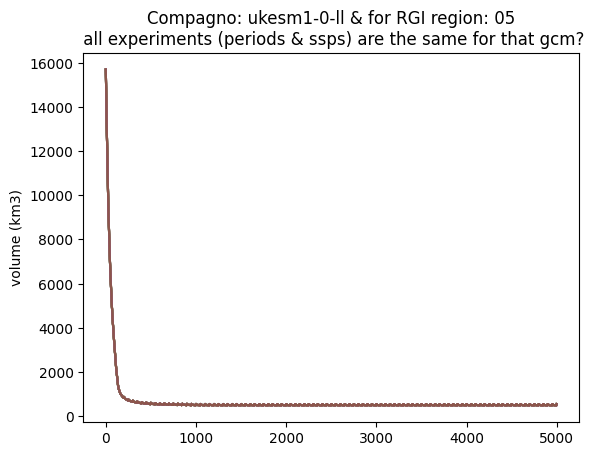

In [29]:
model_author = 'Compagno'
for rgi_reg in ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19']:
    if model_author =='Compagno':
        gcm_l = ['ukesm1-0-ll', 'gfdl-esm4', 'psl_cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0']
    elif model_author == 'Huss':
        gcm_l = ['gfdl-esm4', 'ipsl_cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0', 'ukesm1-0-ll']

    for gcm in gcm_l:
        d_comp_05_problem_l = []
        ### load all volume values 
        ssp = 'hist'
        for p in ['1851-1870', '1901-1920', '1951-1970', '1995-2014']:
            p_05 = f'/home/www/lschuster/glacierMIP3_analysis/{model_author}/{model_author}_rgi{rgi_reg}_sum_{p}_{gcm}_{ssp}.nc'
            d_comp_05_problem_l.append(xr.open_dataset(p_05).volume_m3.values)
        for p in ['2021-2040', '2041-2060', '2061-2080', '2081-2100']:
            for ssp in ['ssp126', 'ssp370', 'ssp585']:
                p_05 = f'/home/www/lschuster/glacierMIP3_analysis/{model_author}/{model_author}_rgi{rgi_reg}_sum_{p}_{gcm}_{ssp}.nc'
                d_comp_05_problem_l.append(xr.open_dataset(p_05).volume_m3.values)
        try:
            # compare the first experiment with the others: 
            # are all the values for every year the same?
            for d in d_comp_05_problem_l[1:]:
                np.testing.assert_allclose(d, d_comp_05_problem_l[0])
            # if this is true, all experiments (periods & GCMs) are the same for that gcm : ukesm1-0-ll
            # visual check:
            for d in d_comp_05_problem_l:
                plt.plot(xr.open_dataset(p_05).simulation_year, d.squeeze()) #, label = gcm)
            plt.title(f'{model_author}: {gcm} & for RGI region: {rgi_reg}\n all experiments (periods & ssps) are the same for that gcm?')
            plt.ylabel('volume (km3)')

        except:
            pass


In [30]:
ds_reg_models = ds_reg_models.sel(model_author=['Rounce', 'Huss','Compagno', 'Kraaijenbrink',
       'GLIMB'])

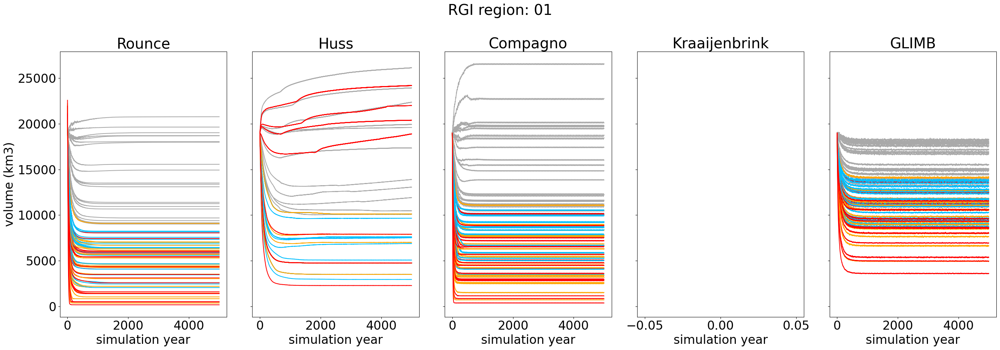

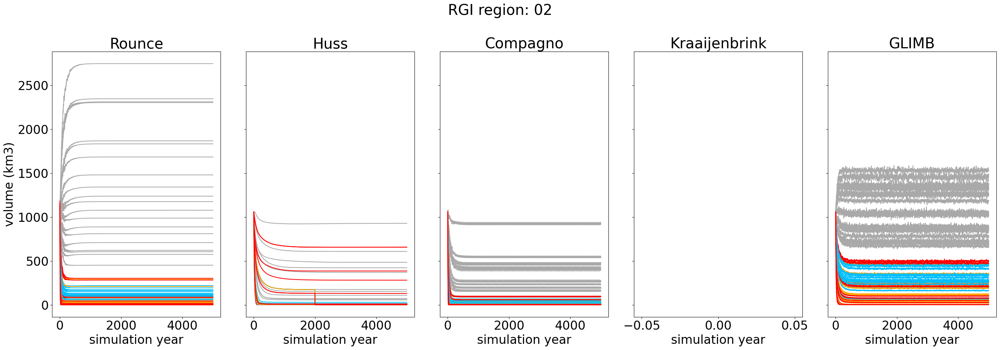

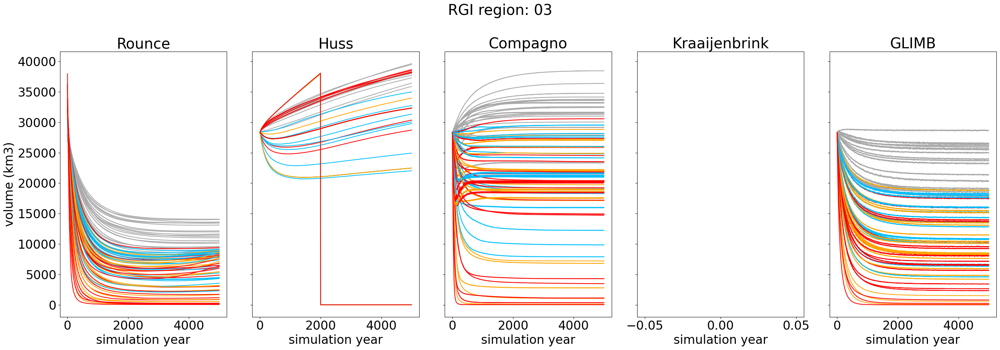

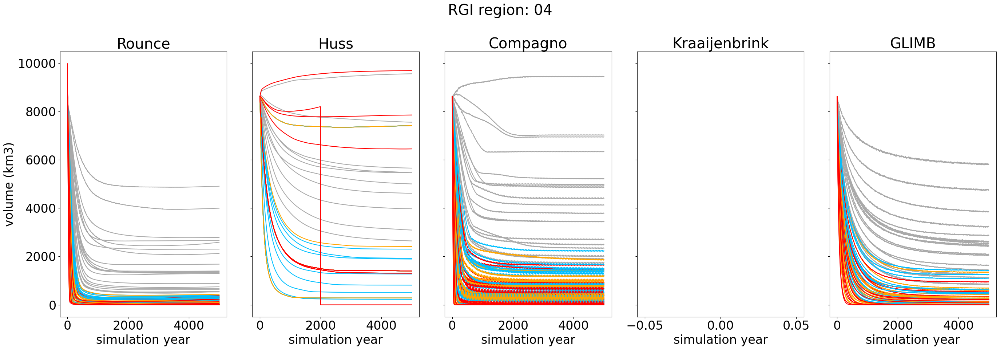

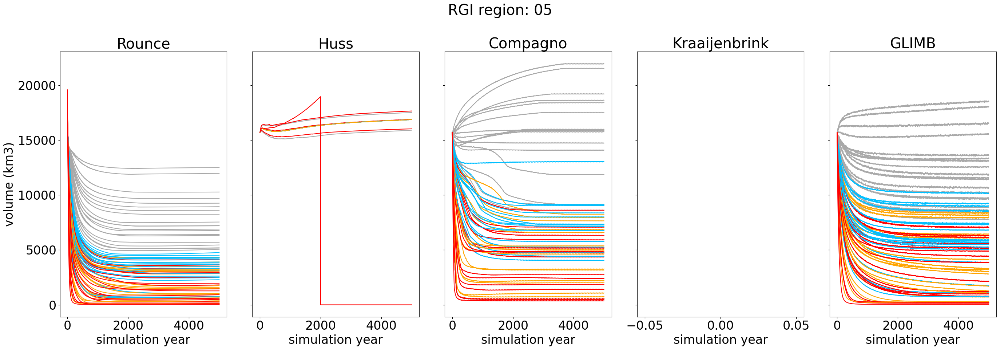

...

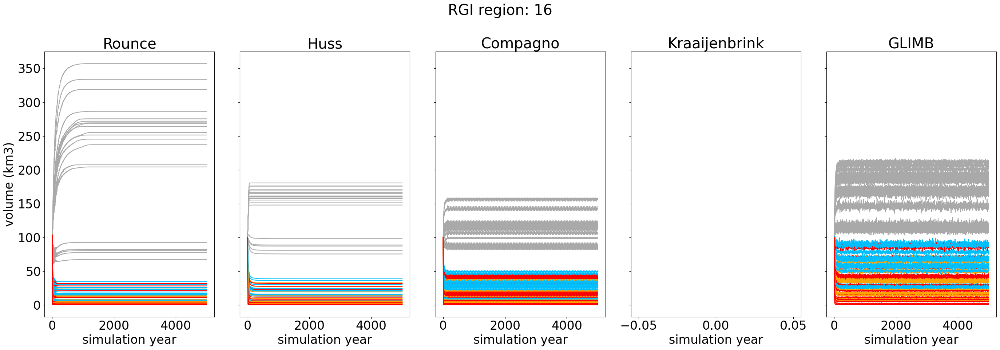

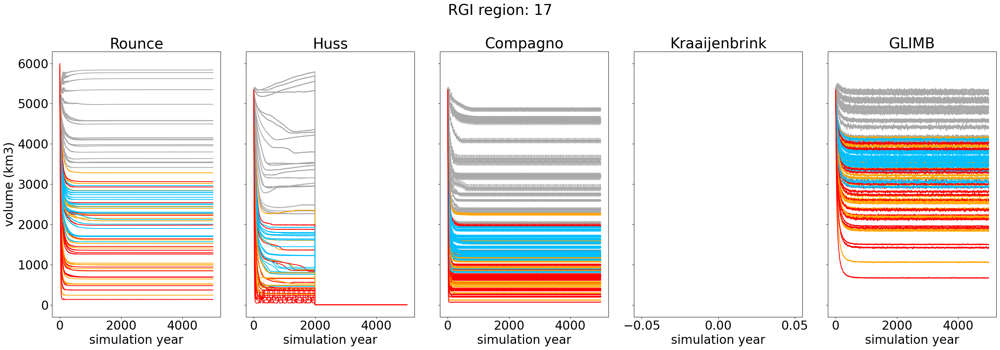

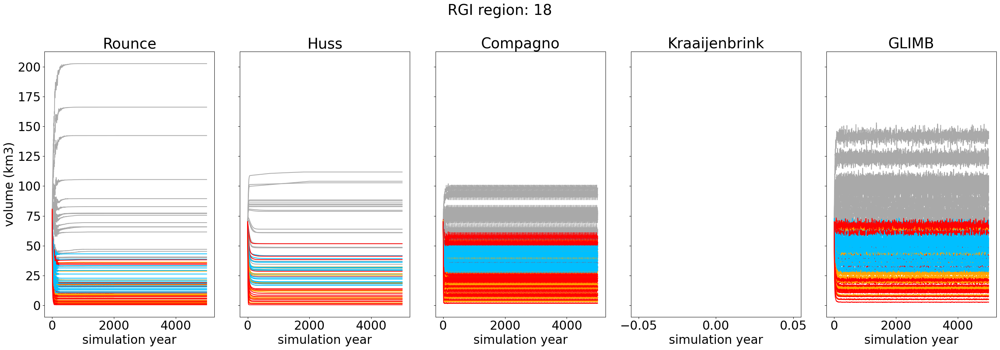

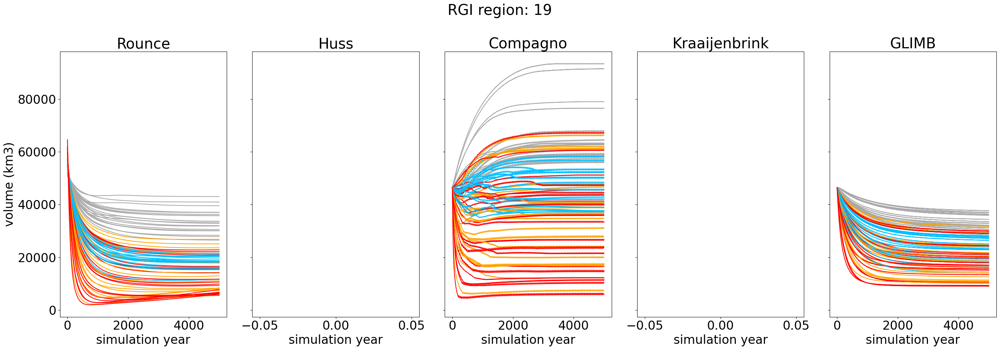

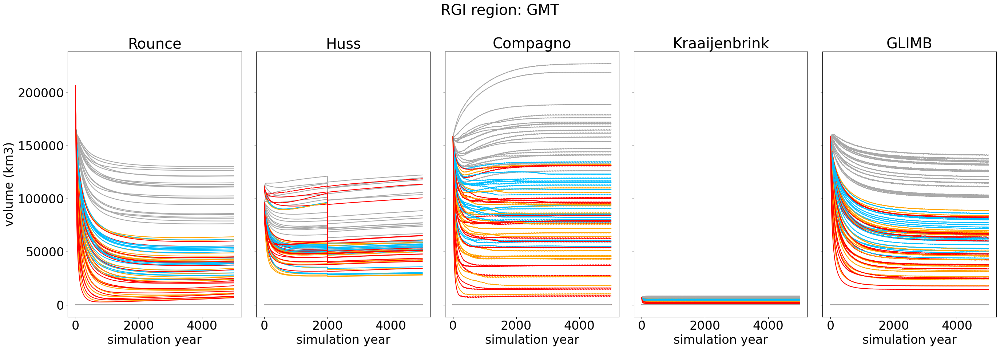

In [31]:
plt.rcParams.update({'font.size': 24})
ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']
for rgi_reg in ds_reg_models.rgi_reg.values[:-1]:
    fig, axs = plt.subplots(1,5,figsize=(28,10), sharey=True)
    for j, model_author in enumerate(ds_reg_models.model_author.values):
    #for j, rgi_reg in enumerate(ds_reg_models.rgi_reg.values[:-1]):
        ax = axs[j]
        for period in ds_reg_models.period:
            for c, ssp in zip(ssp_colors,ds_reg_models.ssp):
                for gcm in ds_reg_models.gcm:
                    try:
                        ax.plot(ds_reg_models.sel(rgi_reg=rgi_reg).sel(model_author=model_author).simulation_year,
                             ds_reg_models.sel(rgi_reg=rgi_reg).sel(model_author=model_author, ssp=ssp, period=period,gcm=gcm).volume_m3/1e9, 
                                 ls='-', color=c, label=ssp)
                        ax.set_xlabel('simulation year')

                    except:
                        print(period)
                        pass

        if j==0:
            ax.set_ylabel('volume (km3)')
            
        ax.set_title(f'{model_author}')
    plt.suptitle(f'RGI region: {rgi_reg}')
    plt.tight_layout()
    plt.savefig(f'/home/www/lschuster/glacierMIP3_analysis/volume_evolution_regional_{rgi_reg}.png')

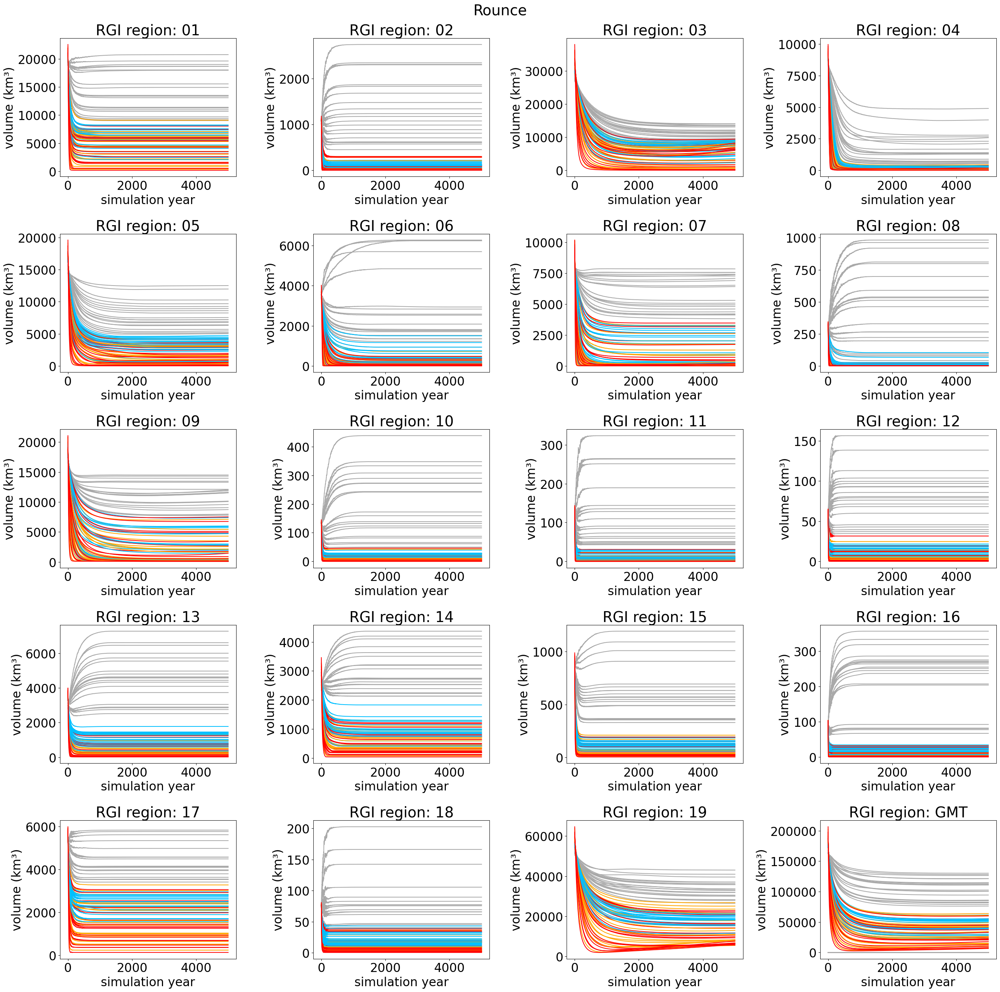

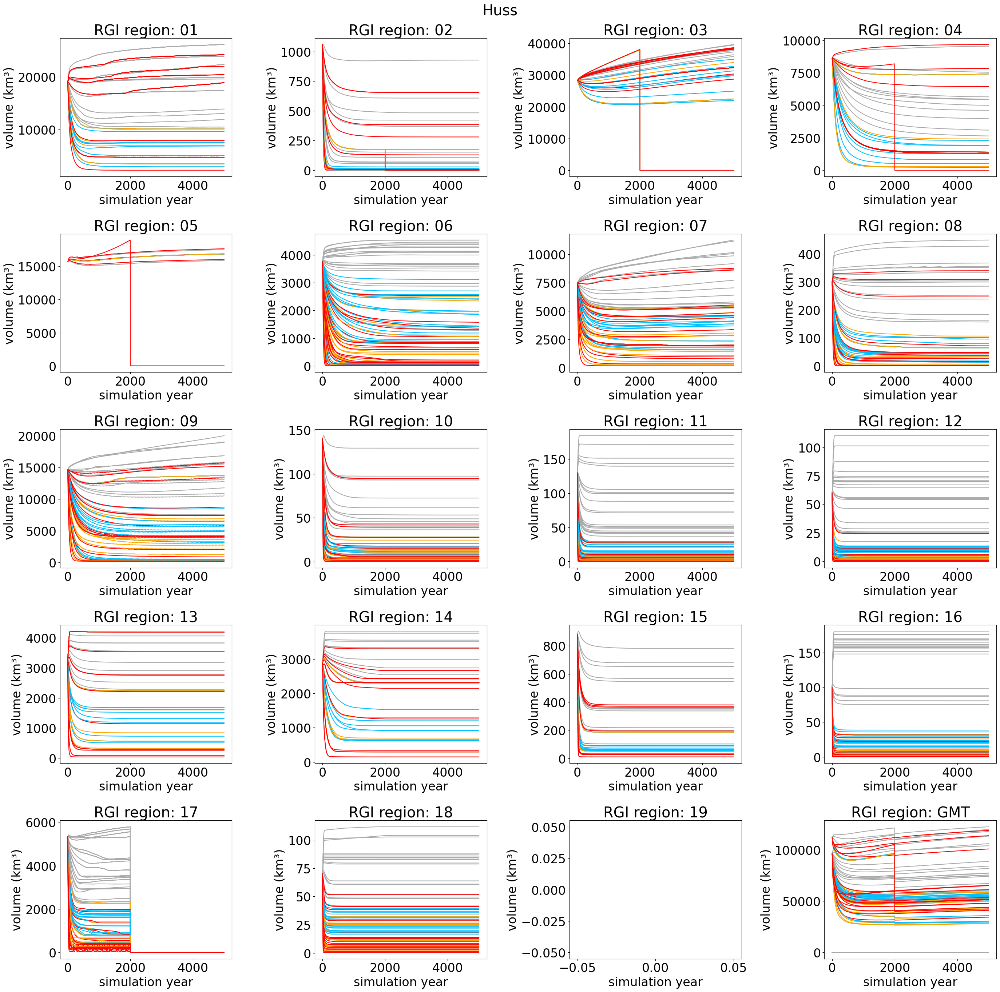

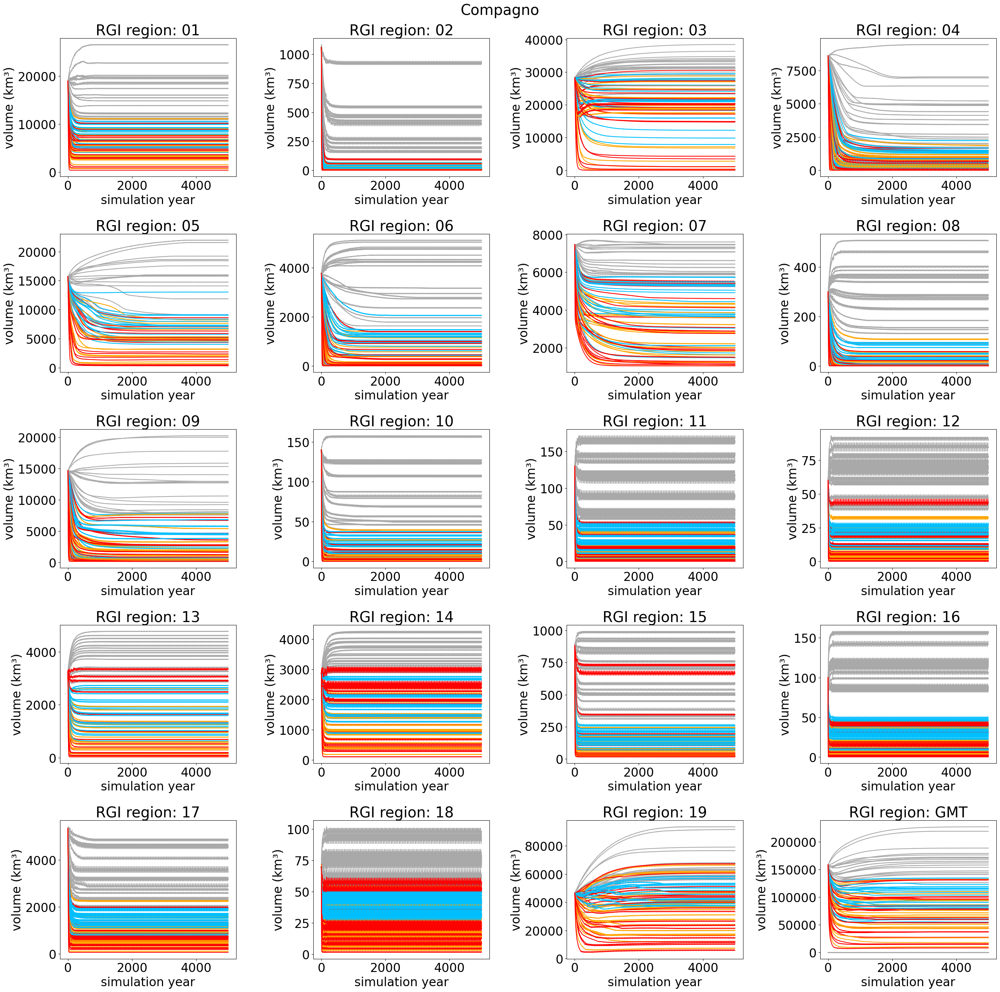

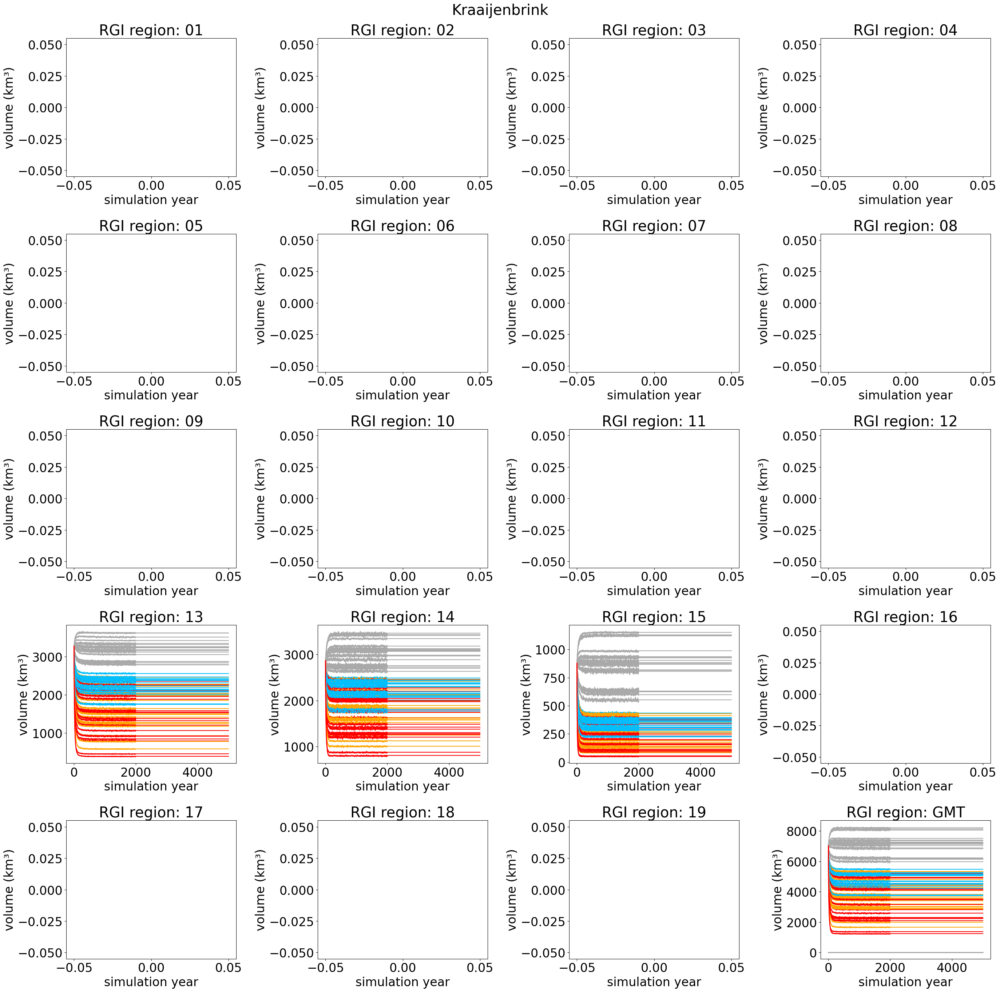

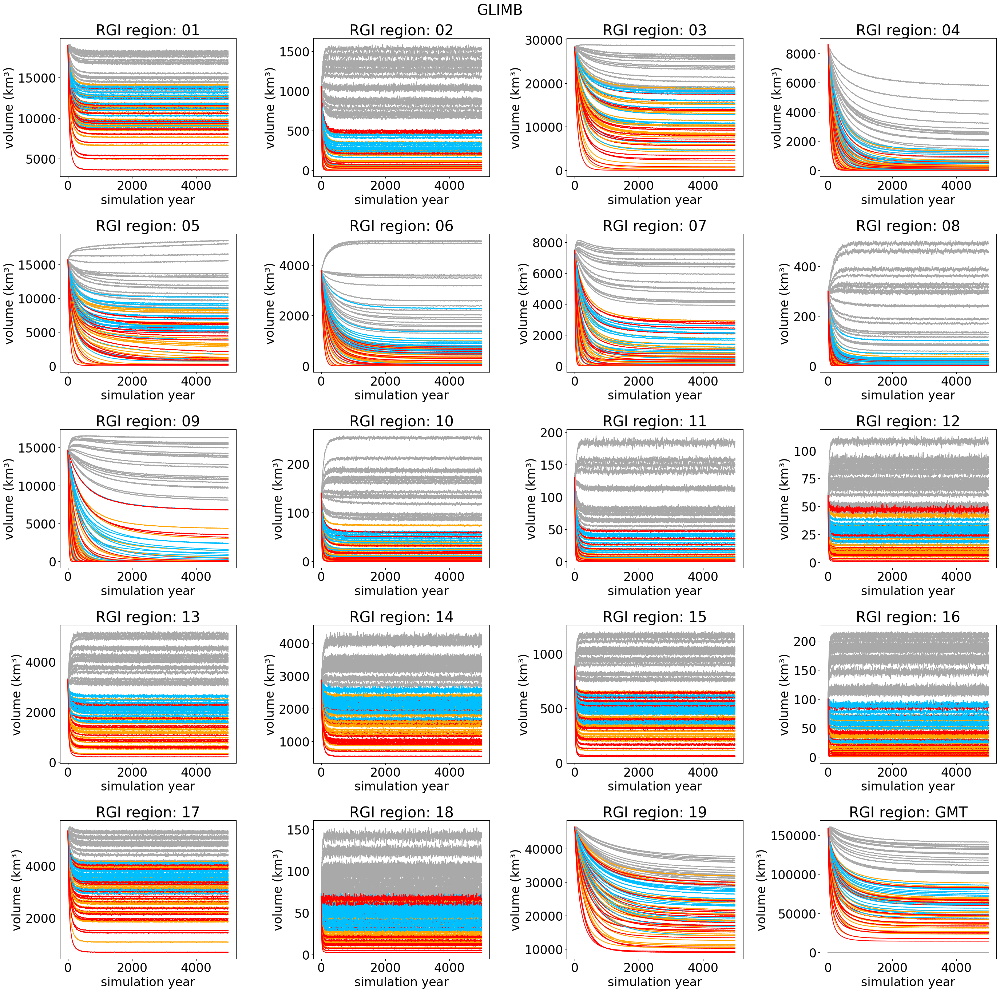

In [16]:
ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']

for model_author in ds_reg_models.model_author.values:
    fig, axs = plt.subplots(5,4,figsize=(28,28))
    for j, rgi_reg in enumerate(ds_reg_models.rgi_reg.values[:-1]):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]
        for period in ds_reg_models.period:
            for c, ssp in zip(ssp_colors,ds_reg_models.ssp):
                for gcm in ds_reg_models.gcm:
                    try:
                        ax.plot(ds_reg_models.sel(rgi_reg=rgi_reg).sel(model_author=model_author).simulation_year,
                             ds_reg_models.sel(rgi_reg=rgi_reg).sel(model_author=model_author, ssp=ssp, period=period,gcm=gcm).volume_m3/1e9, 
                                 ls='-', color=c, label=ssp)
                    except:
                        print(period)
                        pass

        ax.set_xlabel('simulation year')
        ax.set_ylabel('volume (km³)')
        ax.set_title(f'RGI region: {rgi_reg}')
    plt.suptitle(model_author)
    plt.tight_layout()
    plt.savefig(f'/home/www/lschuster/glacierMIP3_analysis/volume_evolution_regional_{model_author}.png')

In [209]:
model_author = 'Huss'
rgi_reg = '05'
ds_reg_models.sel(rgi_reg=rgi_reg, model_author=model_author).volume_m3.sel(simulation_year=slice(1999,5000)).sel(ssp='ssp585').sel(gcm= 'ukesm1-0-ll').sel(period='2081-2100')

<xarray.DataArray 'volume_m3' (simulation_year: 3002)>
array([1.8975373e+13, 0.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00], dtype=float32)
Coordinates:
    model_author     <U4 'Huss'
  * simulation_year  (simulation_year) int16 1999 2000 2001 ... 4998 4999 5000
    period           <U9 '2081-2100'
    gcm              <U11 'ukesm1-0-ll'
    ssp              <U6 'ssp585'
    rgi_reg          <U2 '05'
Attributes:
    units:      m3
    long_name:  Glacier volume at timestamp

In [36]:
d_reg_num_name={}
d_reg_num_name['01'] = 'Alaska'
d_reg_num_name['02'] = 'Western Canada & USA'
d_reg_num_name['03'] = 'Arctic Canada North'
d_reg_num_name['04'] = 'Arctic Canada South'
d_reg_num_name['05'] = 'Greenland'
d_reg_num_name['06'] = 'Iceland'
d_reg_num_name['07'] = 'Svalbard and Jan Mayen'
d_reg_num_name['08'] = 'Scandinavia'
d_reg_num_name['09'] = 'Russian Arctic'
d_reg_num_name['10'] = 'North Asia'
d_reg_num_name['11'] = 'Central Europe'
d_reg_num_name['12'] = 'Caucasus and Middle East'
d_reg_num_name['13'] = 'Central Asia'
d_reg_num_name['14'] = 'South Asia West'
d_reg_num_name['15'] = 'South Asia East'
d_reg_num_name['16'] = 'Low Latitudes'
d_reg_num_name['17'] = 'Southern Andes'
d_reg_num_name['18'] = 'New Zealand'
d_reg_num_name['19'] = 'Antarctic and Subantarctic'

## Relative to GMT:

In [37]:
path_analysis = '/home/www/lschuster/glacierMIP3_analysis/'
pd_temp_diff_1850_1900 = pd.read_csv(path_analysis + 'rgi_reg_glacier_area_weighted_temperature_difference_vs_1850_1900_isimip3b.csv',
                                     index_col= [0])
#pd_temp_diff_1995_2014=pd.read_csv(path_analysis + 'rgi_reg_glacier_area_weighted_temperature_difference_vs_1995_2014_isimip3b.csv', index_col=[0])
pd_temp_diff_1850_1900

,rgi_reg,gcm,deltaT to same GCM,deltaT per deltaGMT to same GCM,deltaT to median GCM,ssp,period,ref_time
0,01,gfdl-esm4,-0.194977,4.263073,0.047629,hist,1851-1870,1850-1900
1,01,ipsl-cm6a-lr,0.133862,2.866323,-0.346073,hist,1851-1870,1850-1900
2,01,mpi-esm1-2-hr,0.206842,33.342171,0.156768,hist,1851-1870,1850-1900
3,01,mri-esm2-0,-0.047110,3.057710,-0.196232,hist,1851-1870,1850-1900
4,01,ukesm1-0-ll,0.221198,33.890158,0.641188,hist,1851-1870,1850-1900
...,...,...,...,...,...,...,...,...
2635,GMT_mean_diff,gfdl-esm4,3.724310,3.724310,3.810978,ssp585,2081-2100,1850-1900
2636,GMT_mean_diff,ipsl-cm6a-lr,6.027920,6.027920,5.671523,ssp585,2081-2100,1850-1900
2637,GMT_mean_diff,mpi-esm1-2-hr,3.913629,3.913629,3.745251,ssp585,2081-2100,1850-1900
2638,GMT_mean_diff,mri-esm2-0,4.387971,4.387971,4.387971,ssp585,2081-2100,1850-1900


In [38]:
pd_temp_diff_1850_1900[pd_temp_diff_1850_1900.rgi_reg == 'GMT']

,rgi_reg,gcm,deltaT to same GCM,deltaT per deltaGMT to same GCM,deltaT to median GCM,ssp,period,ref_time
100,GMT,gfdl-esm4,-0.045735,0.999979,0.072070,hist,1851-1870,1850-1900
101,GMT,ipsl-cm6a-lr,0.046702,1.000020,-0.278557,hist,1851-1870,1850-1900
102,GMT,mpi-esm1-2-hr,0.006205,1.000157,-0.131036,hist,1851-1870,1850-1900
103,GMT,mri-esm2-0,-0.015406,0.999937,0.015732,hist,1851-1870,1850-1900
104,GMT,ukesm1-0-ll,0.006528,1.000141,0.199068,hist,1851-1870,1850-1900
...,...,...,...,...,...,...,...,...
2630,GMT,gfdl-esm4,3.724311,1.000000,3.842117,ssp585,2081-2100,1850-1900
2631,GMT,ipsl-cm6a-lr,6.027921,1.000000,5.702661,ssp585,2081-2100,1850-1900
2632,GMT,mpi-esm1-2-hr,3.913630,1.000000,3.776389,ssp585,2081-2100,1850-1900
2633,GMT,mri-esm2-0,4.387972,1.000000,4.419109,ssp585,2081-2100,1850-1900


In [40]:
pd_init_vol=ds_reg_models.volume_m3.sel(simulation_year=0,model_author='GLIMB').max(dim=['gcm', 'ssp', 'period']).to_dataframe()
rgi_num_order = pd_init_vol['volume_m3'].sort_values(ascending=False).index.drop('GMT')

ValueError: 'ssp' not found in array dimensions ('gcm', 'rgi_reg', 'period_scenario')

In [ ]:
ds_reg_models.sel(model_author='Huss').sel(ssp='ssp585').sel(rgi_reg='11').sel(period='').volume_m3.min()

In [ ]:
ds_reg_models.sel(model_author='Huss').sel(ssp='ssp585').sel(rgi_reg='11').sel(period='2021-2040').volume_m3.min()

In [56]:
ds_reg_models.sel(model_author='Huss').sel(ssp='ssp585').sel(rgi_reg='11').sel(period='2021-2040').volume_m3.min()

<xarray.DataArray 'volume_m3' ()>
array(5.860759e+09, dtype=float32)
Coordinates:
    model_author  <U4 'Huss'
    period        <U9 '2021-2040'
    ssp           <U6 'ssp585'
    rgi_reg       <U2 '11'

In [120]:
ds_reg_models.sel(model_author='Huss').sel(rgi_reg='11').sel(period='2021-2040').volume_m3.sel(simulation_year=1000).std(dim='ssp')

<xarray.DataArray 'volume_m3' (gcm: 5)>
array([6.0566641e+09, 2.8229862e+09, 1.5771049e+09, 1.5784564e+09,
       4.9708912e+08], dtype=float32)
Coordinates:
    model_author     <U4 'Huss'
  * gcm              (gcm) object 'gfdl-esm4' 'ipsl-cm6a-lr' ... 'ukesm1-0-ll'
    period           <U9 '2021-2040'
    simulation_year  int16 1000
    rgi_reg          <U2 '11'

In [125]:
ds_reg_models.sel(model_author='Huss').sel(period='2081-2100').volume_m3.std(dim='ssp').mean(dim='simulation_year')

/home/users/lschuster/.local/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


<xarray.DataArray 'volume_m3' (gcm: 5, rgi_reg: 21)>
array([[8.9013099e+11, 3.2436221e+09, 9.3467017e+11, 7.8057710e+10,
                  nan, 1.2043066e+12, 1.2380744e+12, 2.3890618e+10,
        1.8319994e+12, 3.4050442e+09, 1.4431417e+03, 4.2190753e+09,
        5.8209744e+11, 1.6876429e+11, 1.9818871e+10, 1.0590927e+10,
        2.4378229e+11, 1.2606515e+10,           nan, 1.9628034e+13,
        1.9628034e+13],
       [9.1524684e+12, 3.1386118e+11, 5.8342727e+12, 6.2938369e+11,
                  nan, 4.6474330e+11, 7.3570458e+11, 8.7704289e+09,
        2.1468560e+11, 2.0744536e+09, 4.2090734e+09, 3.4608991e+09,
        2.6545512e+11, 2.5508194e+11, 1.9981672e+10, 6.8367508e+09,
        1.2869968e+11, 1.3087742e+10,           nan, 2.1726853e+13,
        2.1726853e+13],
       [8.2820938e+03, 2.2707779e+02, 5.3466681e+05, 1.4519874e+04,
                  nan, 3.2006239e+11, 8.3322936e+11, 2.2855295e+10,
        1.2851878e+12, 3.3622390e+09, 1.3483390e+10, 4.7069788e+09,
        2.6733342e+04, 0.0000000e+00, 1.4509226e+03, 1.5771710e+10,
        2.1697271e+11, 7.8600622e+09,           nan, 2.2546374e+13,
        2.2546374e+13],
       [8.2820938e+03, 2.2707779e+02, 5.3466681e+05, 1.4519874e+04,
                  nan, 1.3791039e+12, 2.9432885e+04, 2.9843632e+01,
        6.3793090e+04, 2.8461508e+01, 6.4380539e+09, 5.3276995e+09,
        2.6733342e+04, 0.0000000e+00, 1.4509226e+03, 8.6908037e+09,
        1.0552100e+11, 1.0384548e+10,           nan, 2.2300030e+13,
        2.2300030e+13],
       [3.3937005e+12, 8.6119035e+09, 1.0189425e+10, 2.1791535e+12,
        4.9082920e+12, 2.6098319e+10, 3.6439904e+10, 4.5949107e+09,
        1.5931757e+11, 9.7388592e+07, 1.3438717e+09, 1.6965517e+09,
        1.2965858e+10, 6.9764850e+10, 4.1735204e+09, 2.4591429e+09,
        7.9801860e+10, 8.7252787e+09,           nan, 3.0679929e+13,
        3.0679929e+13]], dtype=float32)
Coordinates:
    model_author  <U4 'Huss'
  * gcm           (gcm) object 'gfdl-esm4' 'ipsl-cm6a-lr' ... 'ukesm1-0-ll'
    period        <U9 '2081-2100'
  * rgi_reg       (rgi_reg) object '01' '02' '03' '04' ... '18' '19' 'GMT' 'All'

In [ ]:
www_lschuster/glacierMIP3_analysis/Compagno/Compagno_rgi19_sum_2081-2100_ukesm1-0-ll_ssp585.nc

In [113]:
ds_reg_models.sel(model_author='Huss').sel(ssp='ssp126').sel(rgi_reg='11').sel(period='2081-2100').volume_m3.sel(simulation_year=1000)

<xarray.DataArray 'volume_m3' (gcm: 5)>
array([2.7159161e+10, 8.7523174e+09, 2.9124395e+10, 1.4285347e+10,
       2.6654236e+09], dtype=float32)
Coordinates:
    model_author     <U4 'Huss'
  * gcm              (gcm) object 'gfdl-esm4' 'ipsl-cm6a-lr' ... 'ukesm1-0-ll'
    period           <U9 '2081-2100'
    simulation_year  int16 1000
    ssp              <U6 'ssp126'
    rgi_reg          <U2 '11'

In [114]:
ds_reg_models.sel(model_author='Huss').sel(ssp='ssp585').sel(rgi_reg='11').sel(period='2081-2100').volume_m3.sel(simulation_year=1000)

<xarray.DataArray 'volume_m3' (gcm: 5)>
array([2.7159161e+10, 9.4668992e+07, 6.8309107e+08, 6.8772787e+08,
       4.7344776e+07], dtype=float32)
Coordinates:
    model_author     <U4 'Huss'
  * gcm              (gcm) object 'gfdl-esm4' 'ipsl-cm6a-lr' ... 'ukesm1-0-ll'
    period           <U9 '2081-2100'
    simulation_year  int16 1000
    ssp              <U6 'ssp585'
    rgi_reg          <U2 '11'

In [70]:
ds_reg_models.sel(model_author='Huss').sel(ssp='ssp585').sel(rgi_reg='11').sel(period='2081-2100')['deltaT to same GCM']

<xarray.DataArray 'deltaT to same GCM' (gcm: 5)>
array([4.60833693, 8.32734629, 5.23951141, 4.7137467 , 9.98850547])
Coordinates:
    model_author  <U4 'Huss'
  * gcm           (gcm) object 'gfdl-esm4' 'ipsl-cm6a-lr' ... 'ukesm1-0-ll'
    period        <U9 '2081-2100'
    ssp           <U6 'ssp585'
    rgi_reg       <U2 '11'

array(['gfdl-esm4', 'ipsl-cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0',
       'ukesm1-0-ll'], dtype=object)

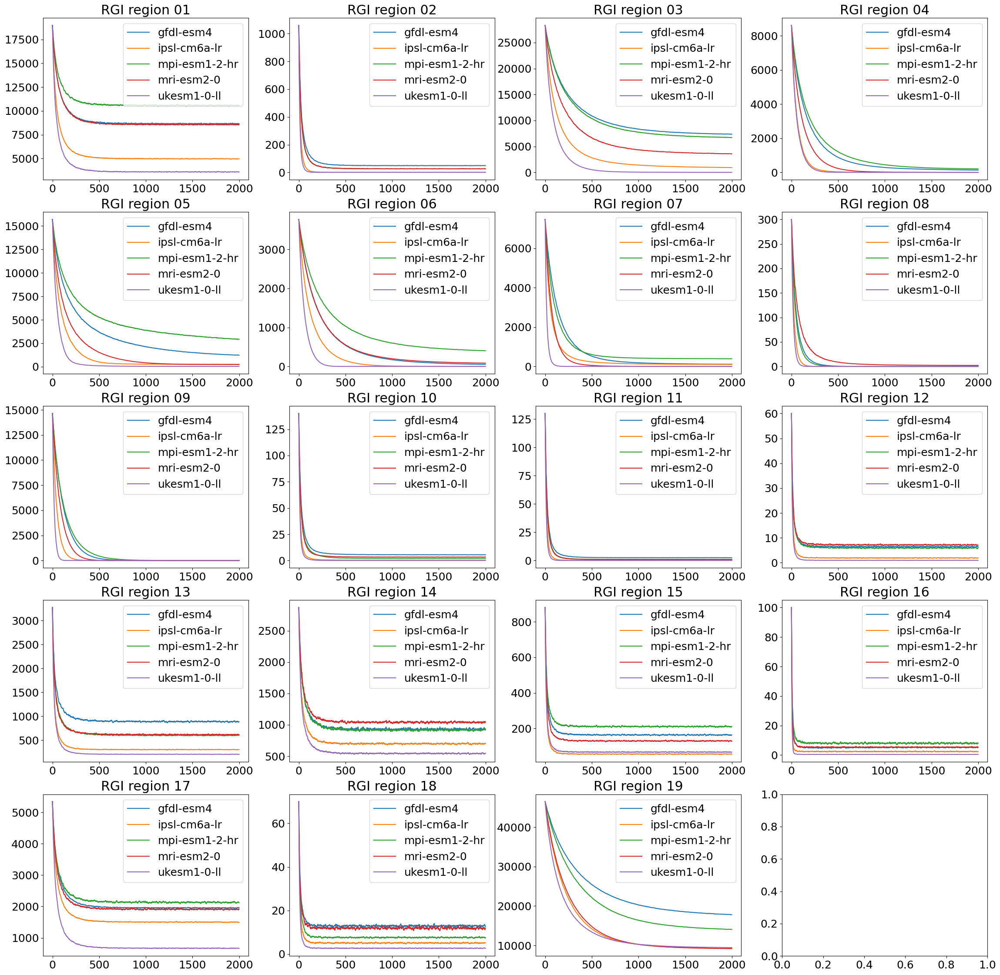

In [102]:
fig, axs = plt.subplots(5,4,figsize=(28,28))
for j, rgi_reg in enumerate(ds_reg_models.rgi_reg.values[:-2]):
    if j<4:
        ax = axs[0][j]
    elif j <8:
        ax = axs[1][j-4]
    elif j <12:
        ax = axs[2][j-8]
    elif j <16:
        ax = axs[3][j-12]
    elif j <20:
        ax = axs[4][j-16]
    for gcm in['gfdl-esm4', 'ipsl-cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0',
           'ukesm1-0-ll']:
        try:
            _path = f'/home/www/lschuster/glacierMIP3_analysis/GLIMB/GLIMB_rgi{rgi_reg}_sum_2081-2100_{gcm}_ssp585.nc'
            _ds = xr.open_dataset(_path).volume_m3/1e9
            ax.plot(np.arange(0,2000),_ds.isel(simulation_year=slice(0,2000)), label=gcm)
        except:
            pass
        ax.set_title(f'RGI region {rgi_reg}')
    ax.legend()
#### ok, this is really strange, but maybe single glaciers are responding very different and e.g. might survive in RGI region 11

Text(0.5, 0.98, 'Compagno')

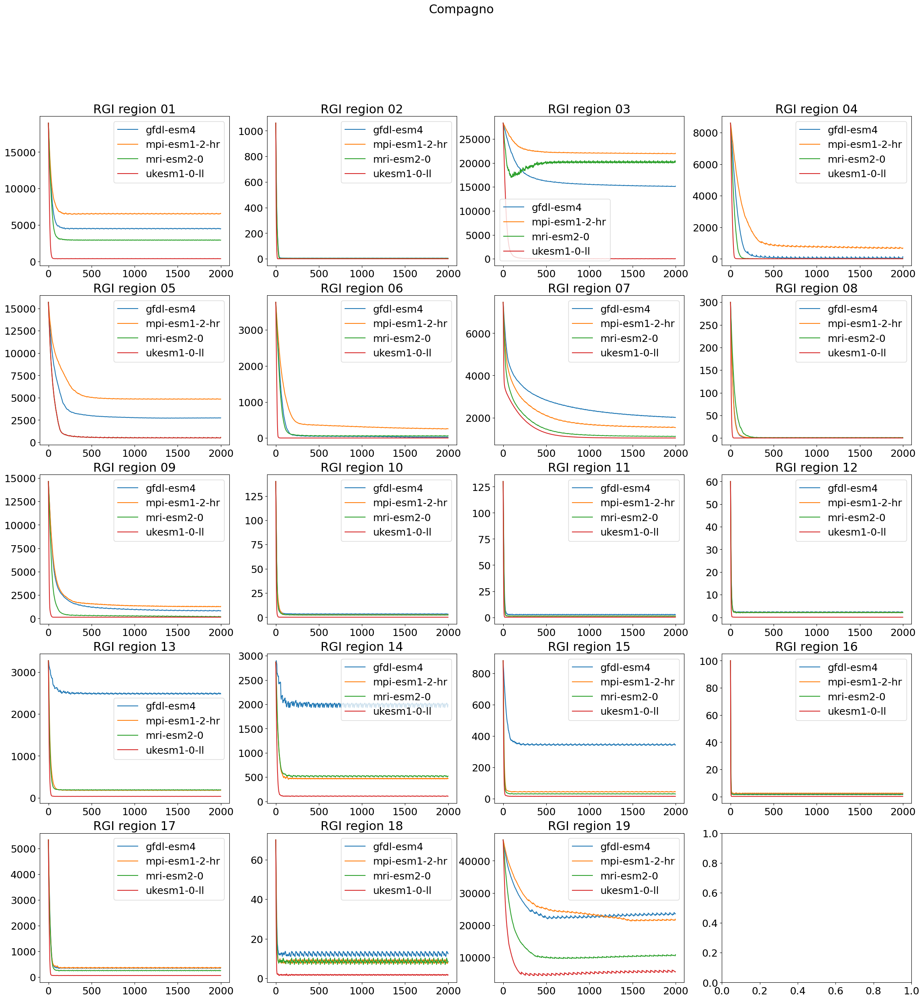

In [108]:
fig, axs = plt.subplots(5,4,figsize=(28,28))
for j, rgi_reg in enumerate(ds_reg_models.rgi_reg.values[:-2]):
    if j<4:
        ax = axs[0][j]
    elif j <8:
        ax = axs[1][j-4]
    elif j <12:
        ax = axs[2][j-8]
    elif j <16:
        ax = axs[3][j-12]
    elif j <20:
        ax = axs[4][j-16]
    for gcm in['gfdl-esm4', 'ipsl_cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0',
           'ukesm1-0-ll']:
        try:
            _path = f'/home/www/lschuster/glacierMIP3_analysis/Compagno/Compagno_rgi{rgi_reg}_sum_2081-2100_{gcm}_ssp585.nc'
            _ds = xr.open_dataset(_path).volume_m3
            ax.plot(np.arange(0,2000),_ds.isel(y=slice(0,2000)), label=gcm)
        except:
            pass
        ax.set_title(f'RGI region {rgi_reg}')
    ax.legend()
plt.suptitle('Compagno')
#### ok, this is really strange, but maybe single glaciers are responding very different and e.g. might survive in RGI region 11

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Text(0.5, 0.98, 'Huss')

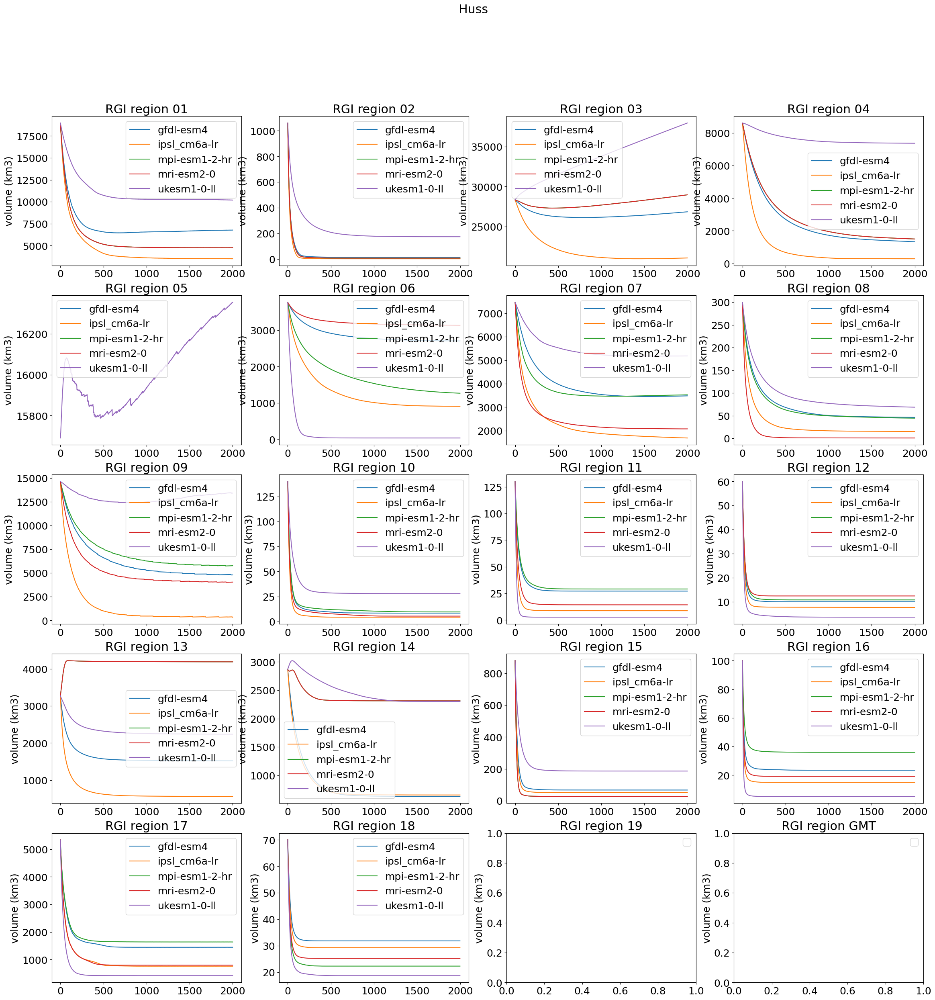

In [110]:
fig, axs = plt.subplots(5,4,figsize=(28,28))
for j, rgi_reg in enumerate(ds_reg_models.rgi_reg.values[:-1]):
    if j<4:
        ax = axs[0][j]
    elif j <8:
        ax = axs[1][j-4]
    elif j <12:
        ax = axs[2][j-8]
    elif j <16:
        ax = axs[3][j-12]
    elif j <20:
        ax = axs[4][j-16]
    for gcm in['gfdl-esm4', 'ipsl_cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0',
           'ukesm1-0-ll']:
        try:
            _path = f'/home/www/lschuster/glacierMIP3_analysis/Huss/Huss_rgi{rgi_reg}_sum_2081-2100_{gcm}_ssp126.nc'
            _ds = xr.open_dataset(_path).volume_m3/1e9
            ax.plot(np.arange(0,2000),_ds.isel(y=slice(0,2000)), label=gcm)
        except:
            pass
        ax.set_title(f'RGI region {rgi_reg}')
        
    ax.legend()
    ax.set_ylabel('volume (km3)')
plt.suptitle('Huss')
#### ok, this is really strange, but maybe single glaciers are responding very different and e.g. might survive in RGI region 11

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Text(0.5, 0.98, 'Huss')

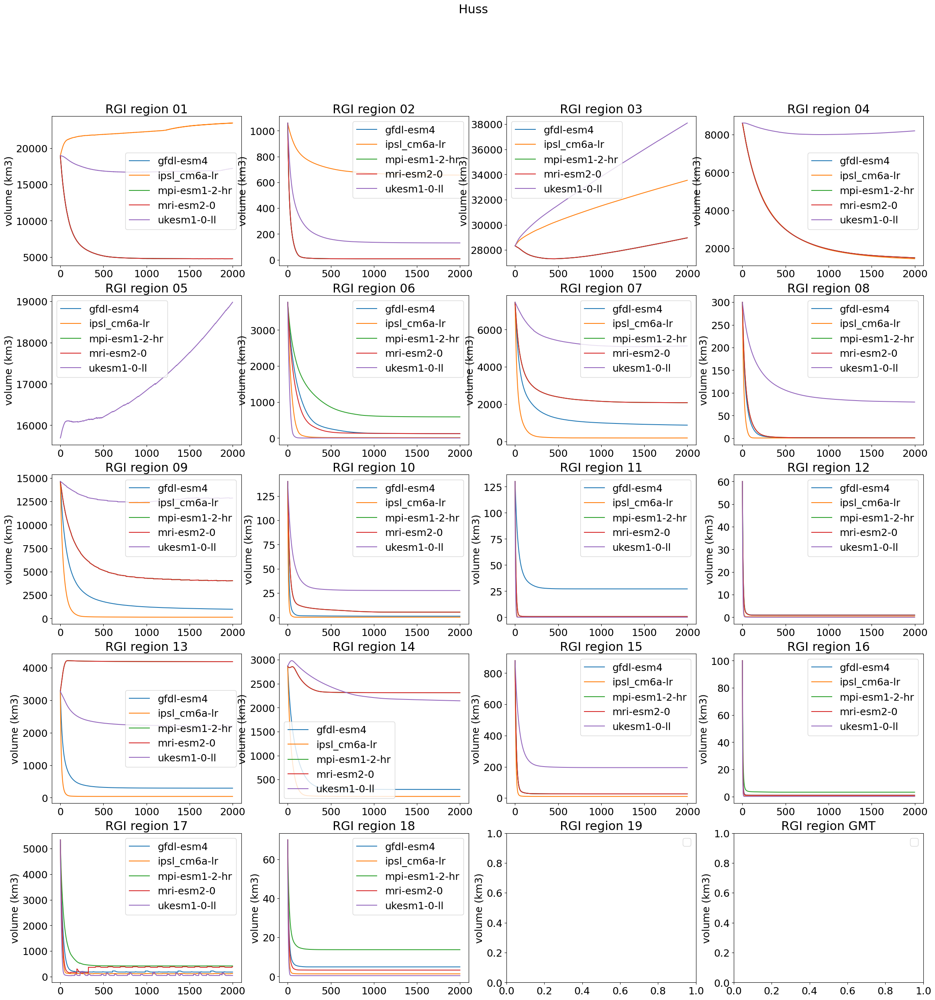

In [109]:
fig, axs = plt.subplots(5,4,figsize=(28,28))
for j, rgi_reg in enumerate(ds_reg_models.rgi_reg.values[:-1]):
    if j<4:
        ax = axs[0][j]
    elif j <8:
        ax = axs[1][j-4]
    elif j <12:
        ax = axs[2][j-8]
    elif j <16:
        ax = axs[3][j-12]
    elif j <20:
        ax = axs[4][j-16]
    for gcm in['gfdl-esm4', 'ipsl_cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0',
           'ukesm1-0-ll']:
        try:
            _path = f'/home/www/lschuster/glacierMIP3_analysis/Huss/Huss_rgi{rgi_reg}_sum_2081-2100_{gcm}_ssp585.nc'
            _ds = xr.open_dataset(_path).volume_m3/1e9
            ax.plot(np.arange(0,2000),_ds.isel(y=slice(0,2000)), label=gcm)
        except:
            pass
        ax.set_title(f'RGI region {rgi_reg}')
        
    ax.legend()
    ax.set_ylabel('volume (km3)')
plt.suptitle('Huss')
#### ok, this is really strange, but maybe single glaciers are responding very different and e.g. might survive in RGI region 11

- ok, some strange things happen in GloGEM (small runaway effect, very strong differences between GCMs), that do not occur for GloGEMFlow ... 

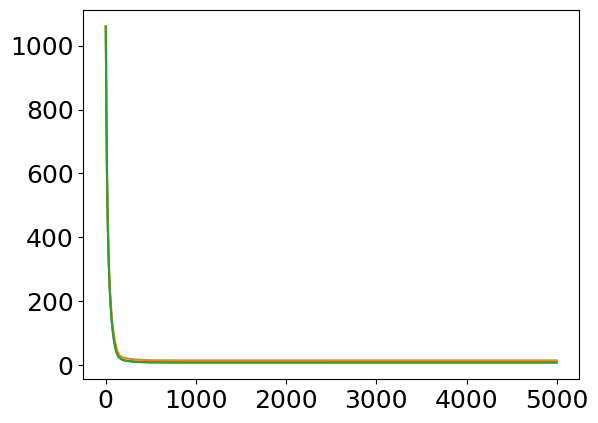

In [129]:
plt.plot(xr.open_dataset('/home/www/lschuster/glacierMIP3_analysis/Huss/Huss_rgi02_sum_2081-2100_gfdl-esm4_ssp585.nc').volume_m3/1e9)
plt.plot(xr.open_dataset('/home/www/lschuster/glacierMIP3_analysis/Huss/Huss_rgi02_sum_2081-2100_gfdl-esm4_ssp126.nc').volume_m3/1e9)
plt.plot(xr.open_dataset('/home/www/lschuster/glacierMIP3_analysis/Huss/Huss_rgi02_sum_2081-2100_gfdl-esm4_ssp370.nc').volume_m3/1e9)

In [140]:
ds_reg_models.period

<xarray.DataArray 'period' (period: 8)>
array(['1851-1870', '1901-1920', '1951-1970', '1995-2014', '2021-2040',
       '2041-2060', '2061-2080', '2081-2100'], dtype=object)
Coordinates:
  * period   (period) object '1851-1870' '1901-1920' ... '2061-2080' '2081-2100'

In [149]:
for j, rgi_reg in enumerate(ds_reg_models.rgi_reg.values[:-2]):
    for gcm in['gfdl-esm4', 'psl_cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0', 'ukesm1-0-ll']:
        for period in ['2021-2040', '2041-2060', '2061-2080', '2081-2100']:
            try:
                _ds1 = xr.open_dataset(f'/home/www/lschuster/glacierMIP3_analysis/Compagno/Compagno_rgi{rgi_reg}_sum_{period}_{gcm}_ssp585.nc').volume_m3
                _ds2 = xr.open_dataset(f'/home/www/lschuster/glacierMIP3_analysis/Compagno/Compagno_rgi{rgi_reg}_sum_{period}_{gcm}_ssp126.nc').volume_m3
                _ds3 = xr.open_dataset(f'/home/www/lschuster/glacierMIP3_analysis/Compagno/Compagno_rgi{rgi_reg}_sum_{period}_{gcm}_ssp370.nc').volume_m3
                np.testing.assert_allclose(_ds1,_ds2)
                np.testing.assert_allclose(_ds1,_ds3)
                print(f'duplicates for {period} and RGI reg{rgi_reg} for gcm: {gcm} ')
            except:
                pass

duplicates for 2021-2040 and RGI reg05 for gcm: ukesm1-0-ll 
duplicates for 2041-2060 and RGI reg05 for gcm: ukesm1-0-ll 
duplicates for 2061-2080 and RGI reg05 for gcm: ukesm1-0-ll 
duplicates for 2081-2100 and RGI reg05 for gcm: ukesm1-0-ll 


duplicates for 2021-2040 and RGI reg01 for gcm: mpi-esm1-2-hr 
duplicates for 2041-2060 and RGI reg01 for gcm: mpi-esm1-2-hr 
duplicates for 2061-2080 and RGI reg01 for gcm: mpi-esm1-2-hr 
duplicates for 2081-2100 and RGI reg01 for gcm: mpi-esm1-2-hr 
duplicates for 2021-2040 and RGI reg01 for gcm: mri-esm2-0 
duplicates for 2041-2060 and RGI reg01 for gcm: mri-esm2-0 
duplicates for 2061-2080 and RGI reg01 for gcm: mri-esm2-0 
duplicates for 2081-2100 and RGI reg01 for gcm: mri-esm2-0 
duplicates for 2021-2040 and RGI reg02 for gcm: mpi-esm1-2-hr 
duplicates for 2041-2060 and RGI reg02 for gcm: mpi-esm1-2-hr 
duplicates for 2061-2080 and RGI reg02 for gcm: mpi-esm1-2-hr 
duplicates for 2081-2100 and RGI reg02 for gcm: mpi-esm1-2-hr 
duplicates for 2021-2040 and RGI reg02 for gcm: mri-esm2-0 
duplicates for 2041-2060 and RGI reg02 for gcm: mri-esm2-0 
duplicates for 2061-2080 and RGI reg02 for gcm: mri-esm2-0 
duplicates for 2081-2100 and RGI reg02 for gcm: mri-esm2-0 
duplicates for 2

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


duplicates for 2021-2040 and RGI reg07 for gcm: mri-esm2-0 
duplicates for 2041-2060 and RGI reg07 for gcm: mri-esm2-0 
duplicates for 2061-2080 and RGI reg07 for gcm: mri-esm2-0 
duplicates for 2081-2100 and RGI reg07 for gcm: mri-esm2-0 
duplicates for 2021-2040 and RGI reg08 for gcm: mri-esm2-0 
duplicates for 2041-2060 and RGI reg08 for gcm: mri-esm2-0 
duplicates for 2061-2080 and RGI reg08 for gcm: mri-esm2-0 
duplicates for 2081-2100 and RGI reg08 for gcm: mri-esm2-0 
duplicates for 2021-2040 and RGI reg09 for gcm: mri-esm2-0 
duplicates for 2041-2060 and RGI reg09 for gcm: mri-esm2-0 
duplicates for 2061-2080 and RGI reg09 for gcm: mri-esm2-0 
duplicates for 2081-2100 and RGI reg09 for gcm: mri-esm2-0 
duplicates for 2021-2040 and RGI reg10 for gcm: mri-esm2-0 
duplicates for 2041-2060 and RGI reg10 for gcm: mri-esm2-0 
duplicates for 2061-2080 and RGI reg10 for gcm: mri-esm2-0 
duplicates for 2081-2100 and RGI reg10 for gcm: mri-esm2-0 
duplicates for 2081-2100 and RGI reg11 f

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


duplicates for 2021-2040 and RGI reg13 for gcm: mpi-esm1-2-hr 
duplicates for 2041-2060 and RGI reg13 for gcm: mpi-esm1-2-hr 
duplicates for 2061-2080 and RGI reg13 for gcm: mpi-esm1-2-hr 
duplicates for 2081-2100 and RGI reg13 for gcm: mpi-esm1-2-hr 
duplicates for 2021-2040 and RGI reg13 for gcm: mri-esm2-0 
duplicates for 2041-2060 and RGI reg13 for gcm: mri-esm2-0 
duplicates for 2061-2080 and RGI reg13 for gcm: mri-esm2-0 
duplicates for 2081-2100 and RGI reg13 for gcm: mri-esm2-0 
duplicates for 2021-2040 and RGI reg14 for gcm: mpi-esm1-2-hr 
duplicates for 2041-2060 and RGI reg14 for gcm: mpi-esm1-2-hr 
duplicates for 2061-2080 and RGI reg14 for gcm: mpi-esm1-2-hr 
duplicates for 2081-2100 and RGI reg14 for gcm: mpi-esm1-2-hr 
duplicates for 2021-2040 and RGI reg14 for gcm: mri-esm2-0 
duplicates for 2041-2060 and RGI reg14 for gcm: mri-esm2-0 
duplicates for 2061-2080 and RGI reg14 for gcm: mri-esm2-0 
duplicates for 2081-2100 and RGI reg14 for gcm: mri-esm2-0 
duplicates for 2

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


duplicates for 2081-2100 and RGI reg15 for gcm: mri-esm2-0 


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


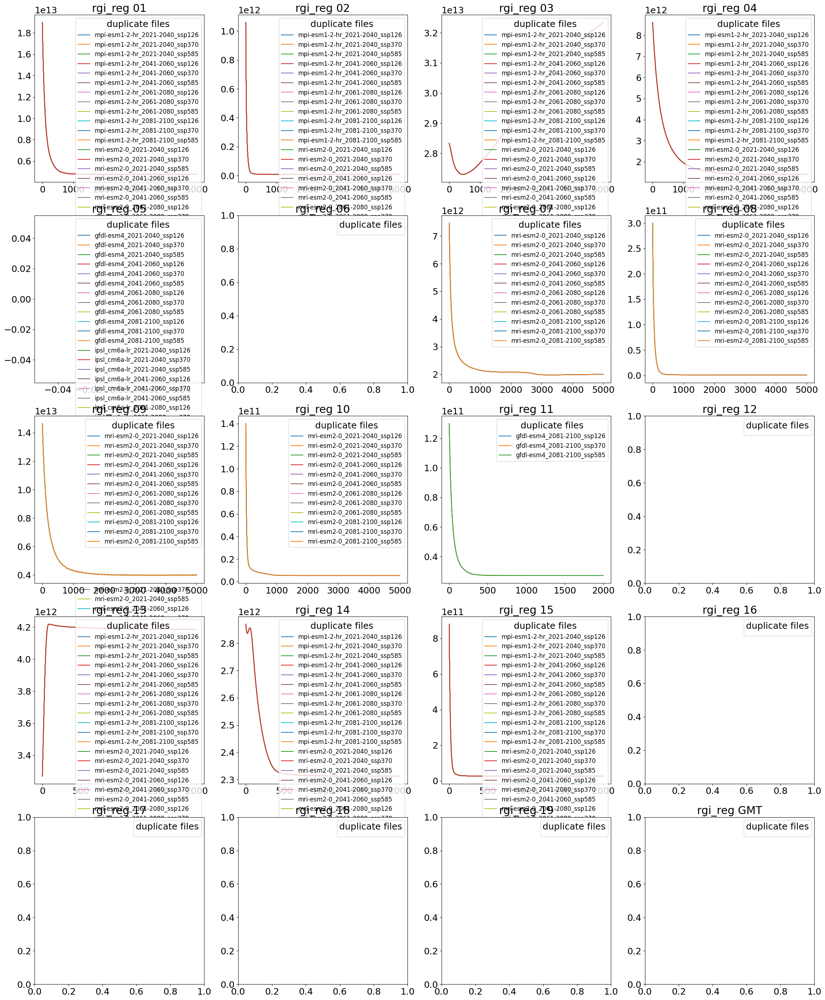

In [160]:
fig, axs = plt.subplots(5,4,figsize=(28,35))
for j, rgi_reg in enumerate(ds_reg_models.rgi_reg.values[:-1]):
    if j<4:
        ax = axs[0][j]
    elif j <8:
        ax = axs[1][j-4]
    elif j <12:
        ax = axs[2][j-8]
    elif j <16:
        ax = axs[3][j-12]
    elif j <20:
        ax = axs[4][j-16]
    for gcm in['gfdl-esm4', 'ipsl_cm6a-lr', 'mpi-esm1-2-hr', 'mri-esm2-0', 'ukesm1-0-ll']:
        for period in ['2021-2040', '2041-2060', '2061-2080', '2081-2100']:
            try:
                _ds1 = xr.open_dataset(f'/home/www/lschuster/glacierMIP3_analysis/Huss/Huss_rgi{rgi_reg}_sum_{period}_{gcm}_ssp585.nc').volume_m3
                _ds2 = xr.open_dataset(f'/home/www/lschuster/glacierMIP3_analysis/Huss/Huss_rgi{rgi_reg}_sum_{period}_{gcm}_ssp126.nc').volume_m3
                _ds3 = xr.open_dataset(f'/home/www/lschuster/glacierMIP3_analysis/Huss/Huss_rgi{rgi_reg}_sum_{period}_{gcm}_ssp370.nc').volume_m3
                np.testing.assert_allclose(_ds1,_ds2)
                np.testing.assert_allclose(_ds1,_ds3)
                ax.plot(_ds2, label=f'{gcm}_{period}_ssp126')
                ax.plot(_ds3, label=f'{gcm}_{period}_ssp370')
                ax.plot(_ds1, label=f'{gcm}_{period}_ssp585')
                print(f'duplicates for {period} and RGI reg{rgi_reg} for gcm: {gcm} ')
            except:
                pass
    ax.set_title(f'rgi_reg {rgi_reg}')
    ax.legend(title='duplicate files', fontsize=12,ncol=1)

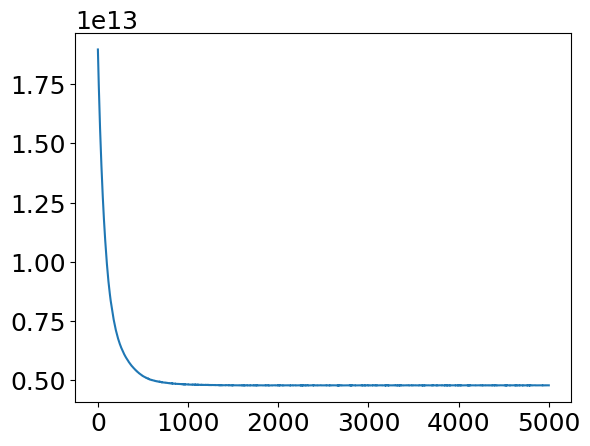

In [74]:
plt.plot(xr.open_dataset('/home/www/lschuster/glacierMIP3_analysis/Huss/Huss_rgi01_sum_2081-2100_gfdl-esm4_ssp585.nc').volume_m3)

In [71]:
ds_reg_models.sel(model_author='Huss').sel(ssp='ssp585').sel(rgi_reg='GMT').sel(period='2081-2100')['deltaT to median GCM']

<xarray.DataArray 'deltaT to median GCM' (gcm: 5)>
array([3.84211654, 5.70266146, 3.77638932, 4.41910917, 6.71033453])
Coordinates:
    model_author  <U4 'Huss'
  * gcm           (gcm) object 'gfdl-esm4' 'ipsl-cm6a-lr' ... 'ukesm1-0-ll'
    period        <U9 '2081-2100'
    ssp           <U6 'ssp585'
    rgi_reg       <U3 'GMT'

In [62]:
ds_reg_models.sel(model_author='Huss').sel(ssp='ssp585').sel(rgi_reg='11').sel(period='2081-2100').volume_m3.isel(simulation_year=[200,500, 1000,2000])

<xarray.DataArray 'volume_m3' (gcm: 5, simulation_year: 4)>
array([[3.0895139e+10, 2.7264801e+10, 2.7159161e+10, 2.7147530e+10],
       [9.4977432e+07, 9.4740960e+07, 9.4668992e+07, 9.4535336e+07],
       [6.9440038e+08, 6.8416032e+08, 6.8309107e+08, 6.8308077e+08],
       [7.0362259e+08, 6.9027763e+08, 6.8772787e+08, 6.8766618e+08],
       [4.7591524e+07, 4.7344776e+07, 4.7344776e+07, 4.7344776e+07]],
      dtype=float32)
Coordinates:
    model_author     <U4 'Huss'
  * gcm              (gcm) object 'gfdl-esm4' 'ipsl-cm6a-lr' ... 'ukesm1-0-ll'
    period           <U9 '2081-2100'
  * simulation_year  (simulation_year) int16 200 500 1000 2000
    ssp              <U6 'ssp585'
    rgi_reg          <U2 '11'

In [68]:
ds_reg_models.sel(model_author='Huss').sel(ssp='ssp370').sel(rgi_reg='11').sel(period='2081-2100').volume_m3.isel(simulation_year=-1)/1e9

<xarray.DataArray 'volume_m3' (gcm: 5)>
array([27.14753   ,  0.44365296,  1.9568455 ,  1.6949431 ,  0.08394574],
      dtype=float32)
Coordinates:
    model_author     <U4 'Huss'
  * gcm              (gcm) object 'gfdl-esm4' 'ipsl-cm6a-lr' ... 'ukesm1-0-ll'
    period           <U9 '2081-2100'
    simulation_year  int16 5000
    ssp              <U6 'ssp370'
    rgi_reg          <U2 '11'

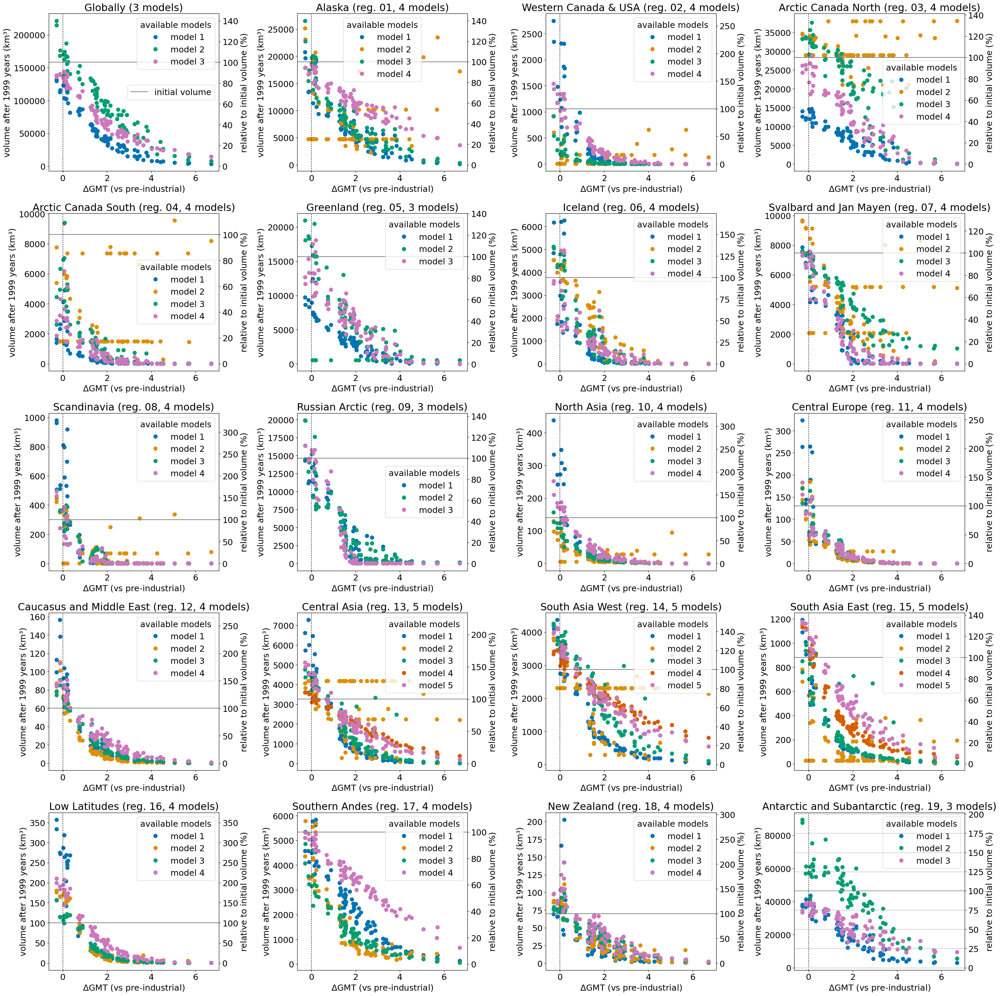

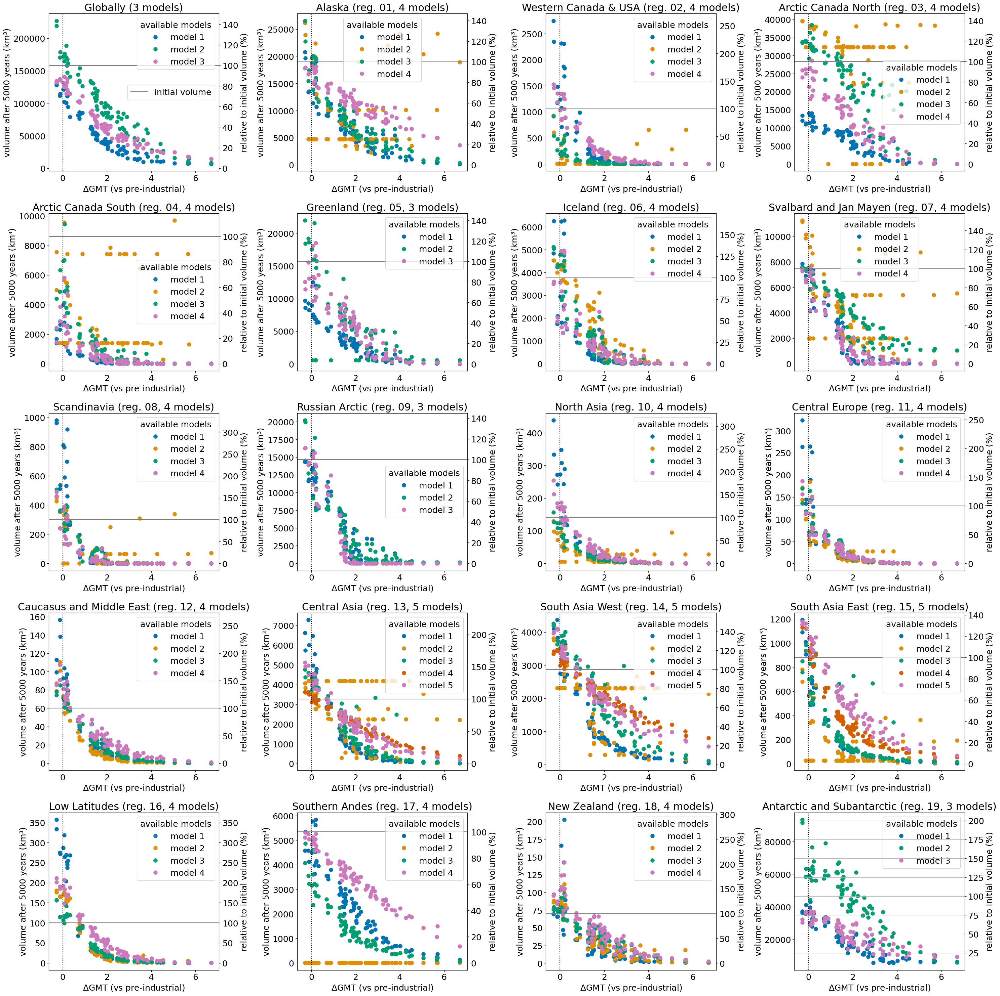

In [48]:
pd_reg_models_count = ds_reg_models.volume_m3.sel(simulation_year=0).to_dataframe().groupby(['rgi_reg', 'model_author'])['volume_m3'].count().reset_index()
pd_reg_models_count = pd_reg_models_count.loc[pd_reg_models_count.rgi_reg !='All']
pd_reg_models_count = pd_reg_models_count.rename(columns={'volume_m3':'n_experiments'})
# models available for each region...
_regional_model = pd_reg_models_count.loc[pd_reg_models_count.n_experiments == 80]

## amount of models per region
reg_n_models = pd_reg_models_count.loc[pd_reg_models_count.n_experiments == 80].groupby('rgi_reg').count()['model_author']
# models that are globally available 
global_models = pd_reg_models_count.groupby('model_author').sum().where(pd_reg_models_count.groupby('model_author').sum() == 80 * 21).dropna().index

# color blind seaborn palette, but want the two Rounce types w. similar color
pal_models = [(0.33725490196078434, 0.7058823529411765, 0.9137254901960784),
               (0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
               (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8, 0.47058823529411764, 0.7372549019607844)]
#pal_models = sns.color_palette(pal_models)
hue_order = ['Rounce_unfilled','Rounce', 'Huss','Compagno', 'Kraaijenbrink',
       'GLIMB']

#ssp_colors = sns.color_palette(['silver', 'deepskyblue', 'orange', 'red'])
#     plt.plot(ds_regional_filled_sel.deltaT.transpose('gcm', 'ssp', 'period').sel(ssp =ssp),
plt.rcParams.update({'font.size': 18})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']

for sim_year in [1999,5000]:
    fig, axs = plt.subplots(5,4,figsize=(30,30)) #, sharey='row') #, sharex=True)
    rgi_regs_global = rgi_num_order
    rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
           '13', '14', '15', '16', '17', '18', '19']
    for j, rgi_reg in enumerate(rgi_regs_global):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]
        if rgi_reg == 'All':
            # only take models that exist globally
            # at the moment Rounce and Glimb, Compagno
            n = len(global_models)
            mj = 0
            for c,m in zip(pal_models, hue_order):
                if m in global_models:
                    mj+=1
                    ax.plot(ds_reg_models['deltaT to median GCM'].sel(rgi_reg='GMT').values.flatten(),
                         ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9,
                         marker='o',markersize=8, lw=0, color=c, label = f'model {mj}')  # instead of m
                else:
                    pass

        else:    
            models_available = _regional_model.loc[_regional_model.rgi_reg==rgi_reg]['model_author'].values
            n = reg_n_models[rgi_reg]
            mj=0
            for c,m in zip(pal_models, hue_order):
                if m in models_available:
                    mj+=1
                    ax.plot(ds_reg_models['deltaT to median GCM'].sel(rgi_reg='GMT').values.flatten(),
                             ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9,
                             marker='o',markersize=8, lw=0, color=c, label = f'model {mj}')  # instead of m

        handles, labels = ax.get_legend_handles_labels()
        #if j == 0 or j ==1:
        leg1 = ax.legend(handles[:6], labels[:6], title ='available models') #, loc='upper left')
        #for c,m in zip(pal_models, ds_reg_models.model_author):
        # if I use max does not matter, I just do not 
        ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max()/1e9, color='grey', label='initial volume') # , loc='upper right')
            #ax.axhspan(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).min()/1e9,
        #                ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).max()/1e9, alpha =0.1, color =c, label='min_max')
        handles, labels = ax.get_legend_handles_labels()
        if j == 0:
            if sim_year <3000:
                loc = 'center right'
                boxi = (1,0.4)
            else:
                loc = 'center left'
                boxi = (0,0.4)
            if rgi_reg == 'All':
                ax.legend([handles[-1]], ['initial volume'], loc ='center right') #, bbox_to_anchor=boxi)
            else:
                ax.legend([handles[-1]], ['initial volume'], loc =loc, bbox_to_anchor=boxi)

            ax.add_artist(leg1)
        ax.set_ylabel(f'volume after {sim_year} years (km³)')

        ax.set_xlabel(f'$\Delta$GMT (vs pre-industrial)') # actually now: vs median global GCM 1850-1900  ... before vs median global GCM 1995-2014
        med_initial_vol = ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max().values/1e9
        initial_vol = f'median: {med_initial_vol:.2f}km3'
        if rgi_reg != 'All':
            nam = d_reg_num_name[rgi_reg]
            ax.set_title(f'{nam} (reg. {rgi_reg}, {n} models)')
        else:
            ax.set_title(f'Globally ({n} models)')
        ax.axvline(0, ls=':', color='k')
        
        def func_vol_to_rel_vol(x):
            return x*100/(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max().values/1e9)

        def func_rel_vol_to_vol(x):
            return x*(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max().values/1e9) / 100
        #secax = ax.secondary_yaxis('right', functions=(func_vol_to_rel_vol,
        #                                               func_rel_vol_to_vol))
        ax2 = ax.twinx()
        
        if rgi_reg == 'All':
            # only take models that exist globally
            # at the moment Rounce and Glimb, Compagno
            n = len(global_models)
            for c,m in zip(pal_models, hue_order):
                if m in global_models:
                    ax2.plot(ds_reg_models['deltaT to median GCM'].sel(rgi_reg='GMT').values.flatten(),
                         100*ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9/med_initial_vol,
                         marker='o',markersize=8, lw=0, color=c, label = m, #instead of m
                             alpha=0)
                else:
                    pass

        else:    
            models_available = _regional_model.loc[_regional_model.rgi_reg==rgi_reg]['model_author'].values
            n = reg_n_models[rgi_reg]

            for c,m in zip(pal_models, hue_order):
                if m in models_available:
                    ax2.plot(ds_reg_models['deltaT to median GCM'].sel(rgi_reg='GMT').values.flatten(),
                             100*ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9/med_initial_vol,
                             marker='o',markersize=8, lw=0, color=c, label = m, # instead of m
                             alpha = 0)
        ax2.set_ylabel('relative to initial volume (%)')
        #ax2.set_ylim([0,400])
        #ax2.plot(100, color='grey') # , label='initial volume')
        #ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max()/1e9, color='grey')
    plt.grid()
    plt.tight_layout()
    
    plt.savefig(path_analysis + f'GlacierMIP3_5models_regional_glacier_{sim_year}yrs_vs_GMT_change_rel_to_1850_1900_of_median_gcm_SIMPLE_new.png')

### Relative to glacier regional temperature change : 

In [ ]:
pd_reg_models_count = ds_reg_models.volume_m3.sel(simulation_year=0).to_dataframe().groupby(['rgi_reg', 'model_author'])['volume_m3'].count().reset_index()
pd_reg_models_count = pd_reg_models_count.loc[pd_reg_models_count.rgi_reg !='All']
pd_reg_models_count = pd_reg_models_count.rename(columns={'volume_m3':'n_experiments'})
# models available for each region...
_regional_model = pd_reg_models_count.loc[pd_reg_models_count.n_experiments == 80]

## amount of models per region
reg_n_models = pd_reg_models_count.loc[pd_reg_models_count.n_experiments == 80].groupby('rgi_reg').count()['model_author']
# models that are globally available 
global_models = pd_reg_models_count.groupby('model_author').sum().where(pd_reg_models_count.groupby('model_author').sum() == 80 * 19).dropna().index

# color blind seaborn palette, but want the two Rounce types w. similar color
pal_models = [(0.33725490196078434, 0.7058823529411765, 0.9137254901960784),
               (0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
               (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8, 0.47058823529411764, 0.7372549019607844)]
#pal_models = sns.color_palette(pal_models)
hue_order = ['Rounce', 'Huss','Compagno', 'Kraaijenbrink',
       'GLIMB']

#ssp_colors = sns.color_palette(['silver', 'deepskyblue', 'orange', 'red'])
#     plt.plot(ds_regional_filled_sel.deltaT.transpose('gcm', 'ssp', 'period').sel(ssp =ssp),
plt.rcParams.update({'font.size': 18})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']

for sim_year in [2000,5000]:
    fig, axs = plt.subplots(5,4,figsize=(30,30))
    rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
           '13', '14', '15', '16', '17', '18', '19']
    for j, rgi_reg in enumerate(rgi_regs_global):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]
        if rgi_reg == 'All':
            # only take models that exist globally
            # at the moment Rounce and Glimb, Compagno
            n = len(global_models)
            for c,m in zip(pal_models, hue_order):
                if m in global_models:
                    ax.plot(ds_reg_models['deltaT to median GCM'].sel(rgi_reg=rgi_reg).values.flatten(),
                         ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9,
                         marker='o',markersize=8, lw=0, color=c, label = m)
                else:
                    pass

        else:    
            models_available = _regional_model.loc[_regional_model.rgi_reg==rgi_reg]['model_author'].values
            n = reg_n_models[rgi_reg]

            for c,m in zip(pal_models, hue_order):
                if m in models_available:
                    ax.plot(ds_reg_models['deltaT to median GCM'].sel(rgi_reg=rgi_reg).values.flatten(),
                             ds_reg_models.volume_m3.sel(simulation_year=5000, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9,
                             marker='o',markersize=8, lw=0, color=c, label = m)

        handles, labels = ax.get_legend_handles_labels()
        #if j == 0 or j ==1:
        leg1 = ax.legend(handles[:6], labels[:6], title ='available models') #, loc='upper left')
        for c,m in zip(pal_models, ds_reg_models.model_author):
            ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).median()/1e9, color=c, label='median')
            ax.axhspan(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).min()/1e9,
                        ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).max()/1e9, alpha =0.1, color =c, label='min_max')
        handles, labels = ax.get_legend_handles_labels()
        if j == 0:
            if sim_year <3000:
                loc = 'center right'
                boxi = (1,0.4)
            else:
                loc = 'center left'
                boxi = (0,0.4)
            ax.legend([handles[-12], handles[-6]], ['median', 'min_max'], title='initial volume', loc = loc, bbox_to_anchor=boxi)
            ax.add_artist(leg1)
        ax.set_ylabel(f'volume after {sim_year}yrs (km³)')

        ax.set_xlabel(f'$\Delta$T (compared to median GCM 1995-2014)')
        med_initial_vol = ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median().values/1e9
        initial_vol = f'median: {med_initial_vol:.2f}km3'
        ax.set_title(f'RGI region: {rgi_reg} (n={n} models)')
        ax.axvline(0, ls=':', color='k')

    plt.tight_layout()

    plt.savefig(path_analysis + f'GlacierMIP3_5models_regional_glacier_{sim_year}yrs_vs_regional_temperature_change_rel_to_ref_period_of_median_gcm_SIMPLE.png')

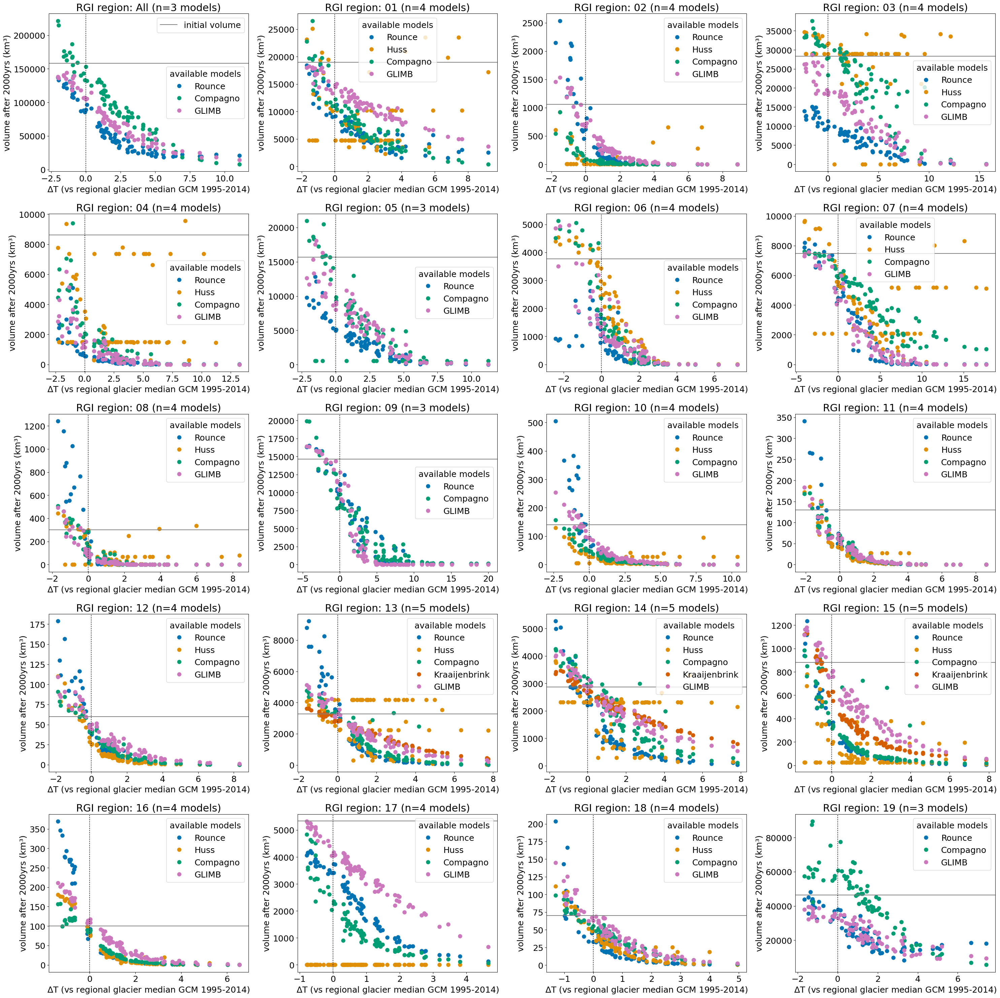

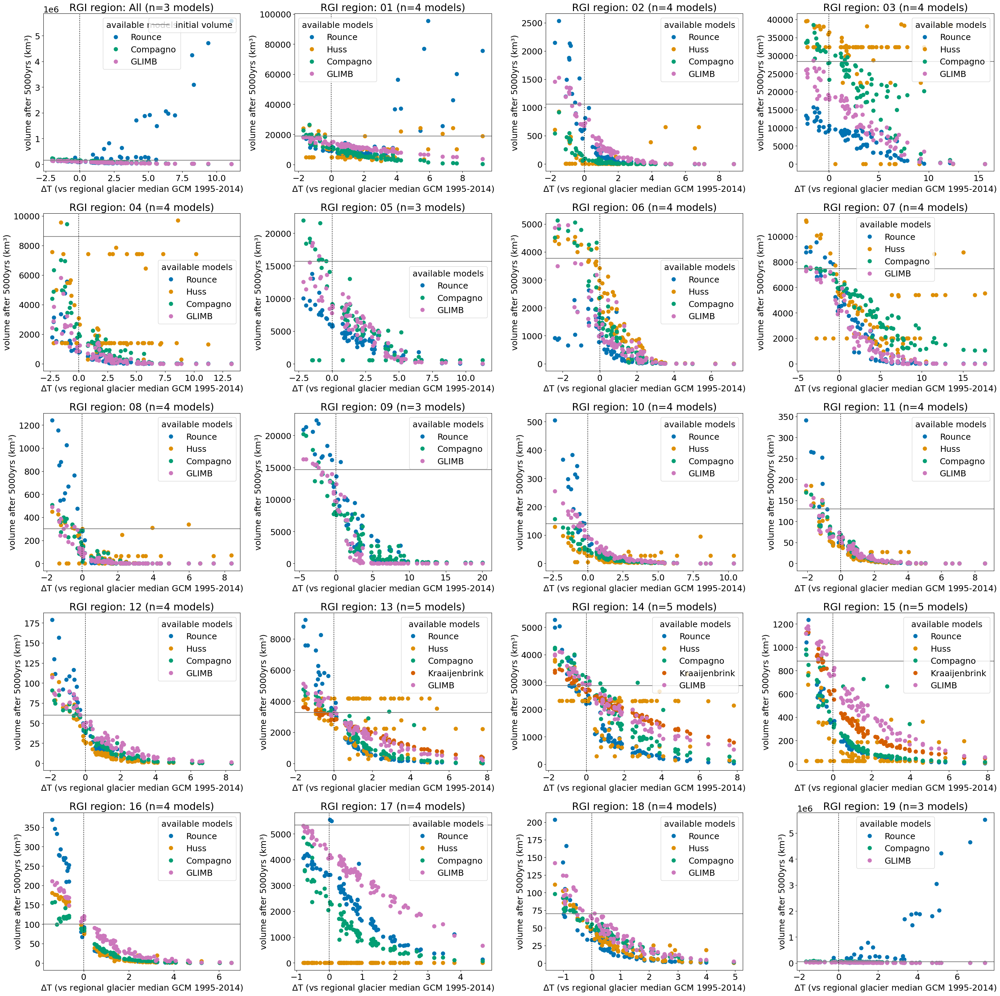

In [89]:
pd_reg_models_count = ds_reg_models.volume_m3.sel(simulation_year=0).to_dataframe().groupby(['rgi_reg', 'model_author'])['volume_m3'].count().reset_index()
pd_reg_models_count = pd_reg_models_count.loc[pd_reg_models_count.rgi_reg !='All']
pd_reg_models_count = pd_reg_models_count.rename(columns={'volume_m3':'n_experiments'})
# models available for each region...
_regional_model = pd_reg_models_count.loc[pd_reg_models_count.n_experiments == 80]

## amount of models per region
reg_n_models = pd_reg_models_count.loc[pd_reg_models_count.n_experiments == 80].groupby('rgi_reg').count()['model_author']
# models that are globally available 
global_models = pd_reg_models_count.groupby('model_author').sum().where(pd_reg_models_count.groupby('model_author').sum() == 80 * 21).dropna().index

# color blind seaborn palette, but want the two Rounce types w. similar color
pal_models = [(0.33725490196078434, 0.7058823529411765, 0.9137254901960784),
               (0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
               (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8, 0.47058823529411764, 0.7372549019607844)]
#pal_models = sns.color_palette(pal_models)
hue_order = ['Rounce_unfilled','Rounce', 'Huss','Compagno', 'Kraaijenbrink',
       'GLIMB']

#ssp_colors = sns.color_palette(['silver', 'deepskyblue', 'orange', 'red'])
#     plt.plot(ds_regional_filled_sel.deltaT.transpose('gcm', 'ssp', 'period').sel(ssp =ssp),
plt.rcParams.update({'font.size': 18})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']

for sim_year in [2000,5000]:
    fig, axs = plt.subplots(5,4,figsize=(30,30))
    rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
           '13', '14', '15', '16', '17', '18', '19']
    for j, rgi_reg in enumerate(rgi_regs_global):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]
        if rgi_reg == 'All':
            # only take models that exist globally
            # at the moment Rounce and Glimb, Compagno
            n = len(global_models)
            for c,m in zip(pal_models, hue_order):
                if m in global_models:
                    ax.plot(ds_reg_models['deltaT to median GCM'].sel(rgi_reg=rgi_reg).values.flatten(),
                         ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9,
                         marker='o',markersize=8, lw=0, color=c, label = m)
                else:
                    pass

        else:    
            models_available = _regional_model.loc[_regional_model.rgi_reg==rgi_reg]['model_author'].values
            n = reg_n_models[rgi_reg]

            for c,m in zip(pal_models, hue_order):
                if m in models_available:
                    ax.plot(ds_reg_models['deltaT to median GCM'].sel(rgi_reg=rgi_reg).values.flatten(),
                             ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9,
                             marker='o',markersize=8, lw=0, color=c, label = m)

        handles, labels = ax.get_legend_handles_labels()
        #if j == 0 or j ==1:
        leg1 = ax.legend(handles[:6], labels[:6], title ='available models') #, loc='upper left')
        #for c,m in zip(pal_models, ds_reg_models.model_author):
        # if I use max does not matter, I just do not 
        ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author='GLIMB').max()/1e9, color='grey', label='initial volume') # , loc='upper right')
            #ax.axhspan(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).min()/1e9,
        #                ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).max()/1e9, alpha =0.1, color =c, label='min_max')
        handles, labels = ax.get_legend_handles_labels()
        if j == 0:
            if sim_year <3000:
                loc = 'center right'
                boxi = (1,0.4)
            else:
                loc = 'center left'
                boxi = (0,0.4)
            ax.legend([handles[-1]], ['initial volume'], loc ='upper right') #, bbox_to_anchor=boxi)
            ax.add_artist(leg1)
        ax.set_ylabel(f'volume after {sim_year}yrs (km³)')

        ax.set_xlabel(f'$\Delta$T (vs regional glacier median GCM 1995-2014)')
        med_initial_vol = ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median().values/1e9
        initial_vol = f'median: {med_initial_vol:.2f}km3'
        ax.set_title(f'RGI region: {rgi_reg} (n={n} models)')
        ax.axvline(0, ls=':', color='k')

    plt.tight_layout()

    plt.savefig(path_analysis + f'GlacierMIP3_5models_regional_glacier_{sim_year}yrs_vs_regional_temperature_change_rel_to_ref_period_of_median_gcm_SIMPLE.png')

### Relative to prcp. change

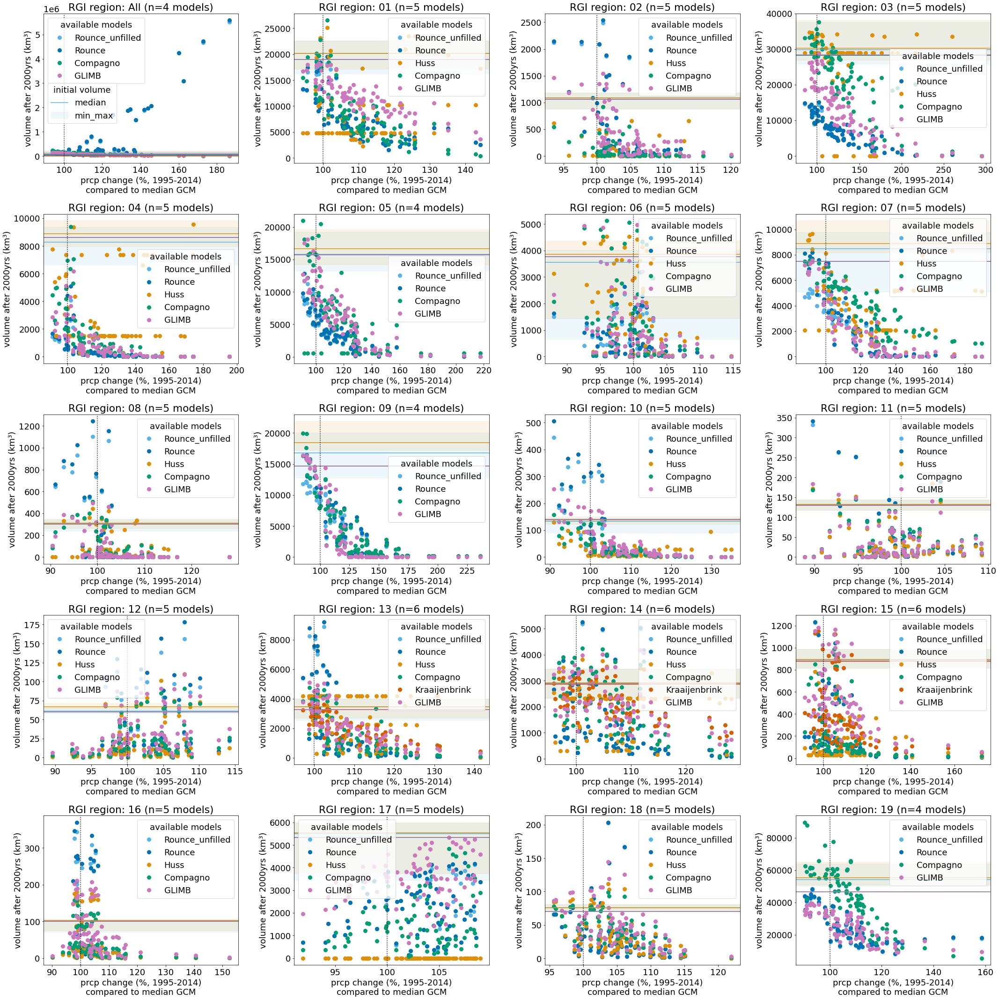

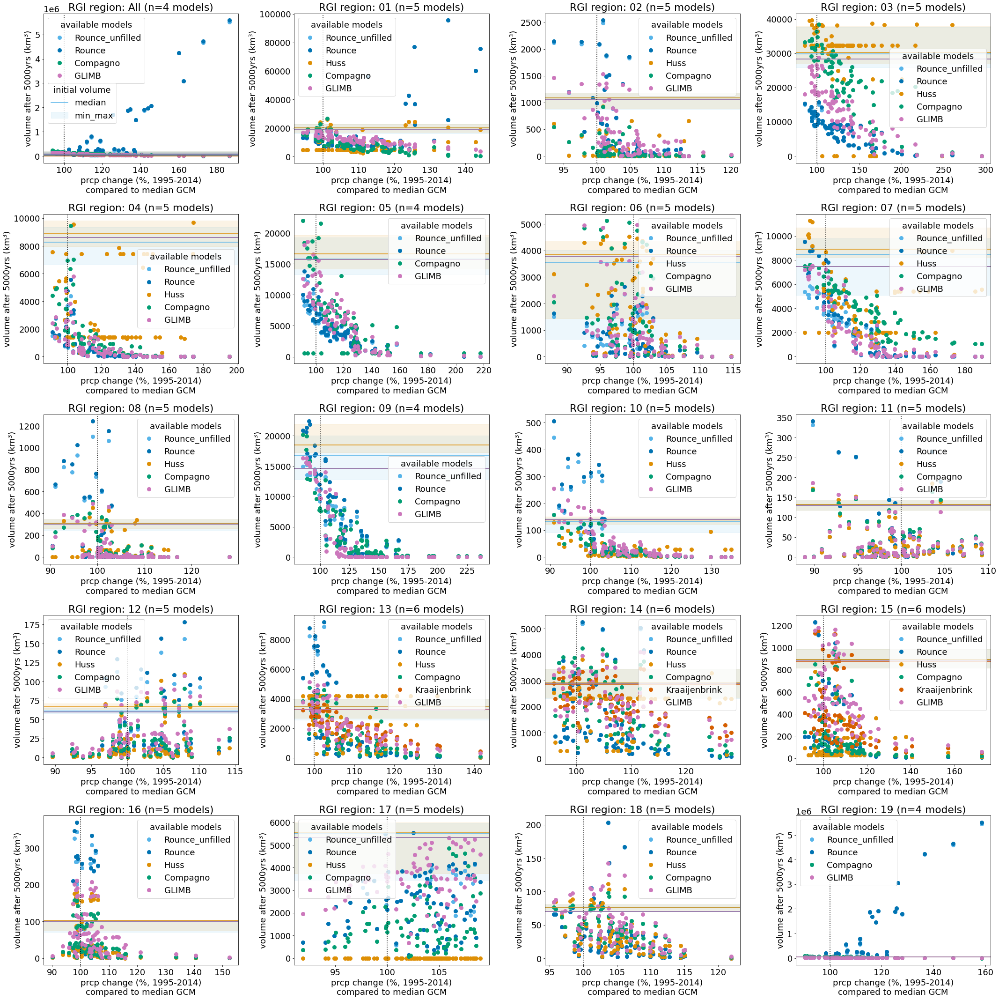

In [14]:
# color blind seaborn palette, but want the two Rounce types w. similar color
pal_models = [(0.33725490196078434, 0.7058823529411765, 0.9137254901960784),
               (0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
               (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8, 0.47058823529411764, 0.7372549019607844)]
#pal_models = sns.color_palette(pal_models)
hue_order = ['Rounce_unfilled',  'Rounce', 'Huss','Compagno', 'Kraaijenbrink',
       'GLIMB']

#ssp_colors = sns.color_palette(['silver', 'deepskyblue', 'orange', 'red'])
#     plt.plot(ds_regional_filled_sel.deltaT.transpose('gcm', 'ssp', 'period').sel(ssp =ssp),
#plt.rcParams.update({'font.size': 20})
plt.rcParams.update({'font.size': 18})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']
for sim_year in [2000,5000]:

    fig, axs = plt.subplots(5,4,figsize=(30,30))
    rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
           '13', '14', '15', '16', '17', '18', '19']
    for j, rgi_reg in enumerate(rgi_regs_global):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]  

        if rgi_reg == 'All':
            # only take models that exist globally
            # at the moment Rounce and Glimb
            n = len(global_models)
            for c,m in zip(pal_models, hue_order):
                if m in global_models:
                    ax.plot(ds_reg_models['prcp change (%) to median GCM'].sel(rgi_reg=rgi_reg).values.flatten(),
                         ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9,
                         marker='o',markersize=8, lw=0, color=c, label = m)
                else:
                    pass     
        else:    
            models_available = _regional_model.loc[_regional_model.rgi_reg==rgi_reg]['model_author'].values
            n = reg_n_models[rgi_reg]

            for c,m in zip(pal_models, hue_order):
                if m in models_available:
                    ax.plot(ds_reg_models['prcp change (%) to median GCM'].sel(rgi_reg=rgi_reg).values.flatten(),
                             ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9,
                             marker='o',markersize=8, lw=0, color=c, label = m)

        handles, labels = ax.get_legend_handles_labels()
        #if j == 0 or j ==1:
        leg1 = ax.legend(handles[:6], labels[:6], title ='available models') #, loc='upper left')
        #if j == 0 or j == 1:
        #    leg1 = ax.legend(handles[:6], labels[:6])
        for c,m in zip(pal_models, ds_reg_models.model_author):
            ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).median()/1e9, color=c, label='median')
            ax.axhspan(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).min()/1e9,
                        ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).max()/1e9, alpha =0.1, color =c, label='min_max')
        handles, labels = ax.get_legend_handles_labels()
        if j == 0:
            ax.legend([handles[-12], handles[-6]], ['median', 'min_max'], title='initial volume', loc = 'center left', bbox_to_anchor=(0,0.4))
            ax.add_artist(leg1)
        #ax.set_ylabel('"equilibrium" volume (km³)')
        ax.set_ylabel(f'volume after {sim_year}yrs (km³)')

        #ax.set_xlabel(f'$\Delta$T (compared to median GCM 1995-2014)')
        ax.set_xlabel(f'prcp change (%, 1995-2014)\ncompared to median GCM')
        med_initial_vol = ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median().values/1e9
        initial_vol = f'median: {med_initial_vol:.2f}km3'
        #ax.set_title(f'RGI region: {rgi_reg}')
        ax.set_title(f'RGI region: {rgi_reg} (n={n} models)')

        ax.axvline(100, ls=':', color='k')

    plt.tight_layout()

    plt.savefig(path_analysis + f'GlacierMIP3_5models_regional_glacier_{sim_year}yrs_vs_regional_prcp_change_rel_to_ref_period_of_median_gcm.png')

--- 

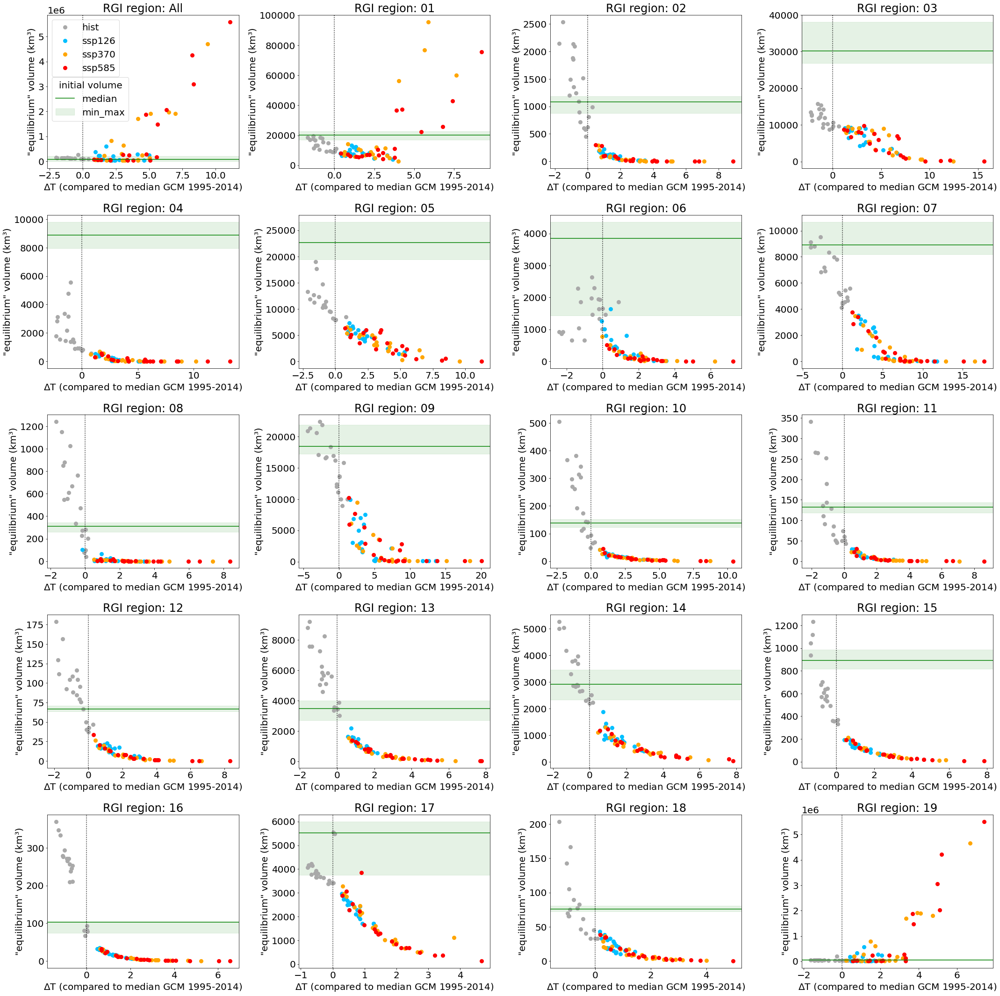

In [38]:
#ssp_colors = sns.color_palette(['silver', 'deepskyblue', 'orange', 'red'])
#     plt.plot(ds_regional_filled_sel.deltaT.transpose('gcm', 'ssp', 'period').sel(ssp =ssp),
plt.rcParams.update({'font.size': 20})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']
fig, axs = plt.subplots(5,4,figsize=(30,30))
rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19']
for j, rgi_reg in enumerate(rgi_regs_global):
    if j<4:
        ax = axs[0][j]
    elif j <8:
        ax = axs[1][j-4]
    elif j <12:
        ax = axs[2][j-8]
    elif j <16:
        ax = axs[3][j-12]
    elif j <20:
        ax = axs[4][j-16]
        
    for c,ssp in zip(ssp_colors, ds_regional_filled.ssp.values):
        ax.plot(ds_reg_models['deltaT to median GCM'].sel(ssp =ssp, rgi_reg=rgi_reg),
                 ds_reg_models.volume_m3.sel(simulation_year=5000, rgi_reg=rgi_reg, ssp=ssp).squeeze()/1e9,
                 marker='o',markersize=8, lw=0, color=c, label = ssp)
    handles, labels = ax.get_legend_handles_labels()
    if j == 0:
        leg1 = ax.legend(handles[::8], labels[::8])
    ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median()/1e9, color='green', label='median')
    ax.axhspan(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).min()/1e9,
                ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).max()/1e9, alpha =0.1, color = 'green', label='min_max')
    handles, labels = ax.get_legend_handles_labels()
    if j == 0:
        ax.legend([handles[-2], handles[-1]], ['median', 'min_max'], title='initial volume', loc = 'center left', bbox_to_anchor=(0,0.45))
        ax.add_artist(leg1)
    ax.set_ylabel('"equilibrium" volume (km³)')
    ax.set_xlabel(f'$\Delta$T (compared to median GCM 1995-2014)')
    med_initial_vol = ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median().values/1e9
    initial_vol = f'median: {med_initial_vol:.2f}km3'
    ax.set_title(f'RGI region: {rgi_reg}')
    ax.axvline(0, ls=':', color='k')
    
plt.tight_layout()

#plt.savefig(path_analysis + f'{model_author}_regional_glacier_vs_temperature_change_rel_to_ref_period_of_median_gcm.png')

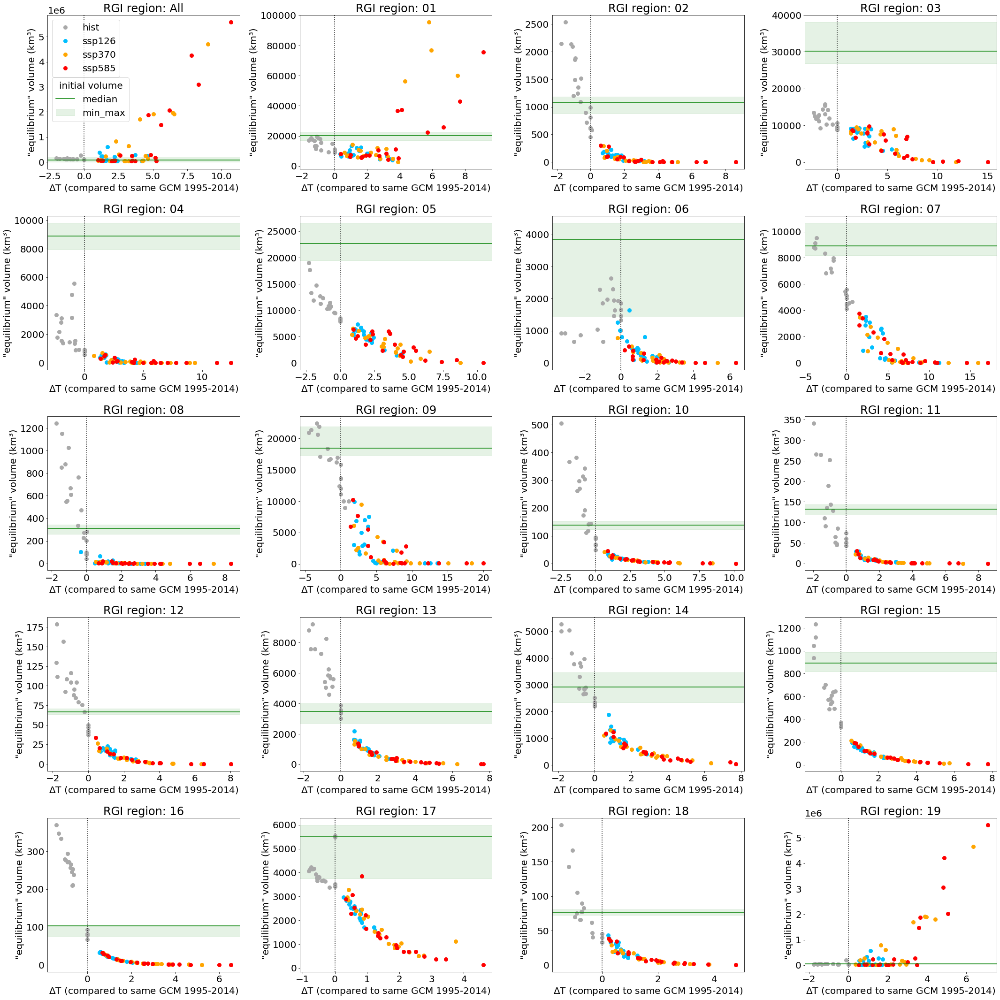

In [39]:
#ssp_colors = sns.color_palette(['silver', 'deepskyblue', 'orange', 'red'])
#     plt.plot(ds_regional_filled_sel.deltaT.transpose('gcm', 'ssp', 'period').sel(ssp =ssp),
plt.rcParams.update({'font.size': 20})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']
fig, axs = plt.subplots(5,4,figsize=(30,30))
rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19']
for j, rgi_reg in enumerate(rgi_regs_global):
    if j<4:
        ax = axs[0][j]
    elif j <8:
        ax = axs[1][j-4]
    elif j <12:
        ax = axs[2][j-8]
    elif j <16:
        ax = axs[3][j-12]
    elif j <20:
        ax = axs[4][j-16]
        
    for c,ssp in zip(ssp_colors, ds_regional_filled.ssp.values):
        ax.plot(ds_regional_filled['deltaT to same GCM'].sel(ssp =ssp, rgi_reg=rgi_reg),
                 ds_regional_filled.volume_m3.sel(simulation_year=5000, rgi_reg=rgi_reg, ssp=ssp).squeeze()/1e9,
                 marker='o',markersize=8, lw=0, color=c, label = ssp)
    handles, labels = ax.get_legend_handles_labels()
    if j == 0:
        leg1 = ax.legend(handles[::8], labels[::8])
    ax.axhline(ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median()/1e9, color='green', label='median')
    ax.axhspan(ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).min()/1e9,
                ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).max()/1e9, alpha =0.1, color = 'green', label='min_max')
    handles, labels = ax.get_legend_handles_labels()
    if j == 0:
        ax.legend([handles[-2], handles[-1]], ['median', 'min_max'], title='initial volume', loc = 'center left', bbox_to_anchor=(0,0.45))
        ax.add_artist(leg1)
    ax.set_ylabel('"equilibrium" volume (km³)')
    ax.set_xlabel(f'$\Delta$T (compared to same GCM 1995-2014)')
    med_initial_vol = ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median().values/1e9
    initial_vol = f'median: {med_initial_vol:.2f}km3'
    ax.set_title(f'RGI region: {rgi_reg}')
    ax.axvline(0, ls=':', color='k')
    
plt.tight_layout()

plt.savefig(path_analysis + f'{model_author}_regional_glacier_vs_temperature_change_relative_to_ref_period_of_same_gcm.png')

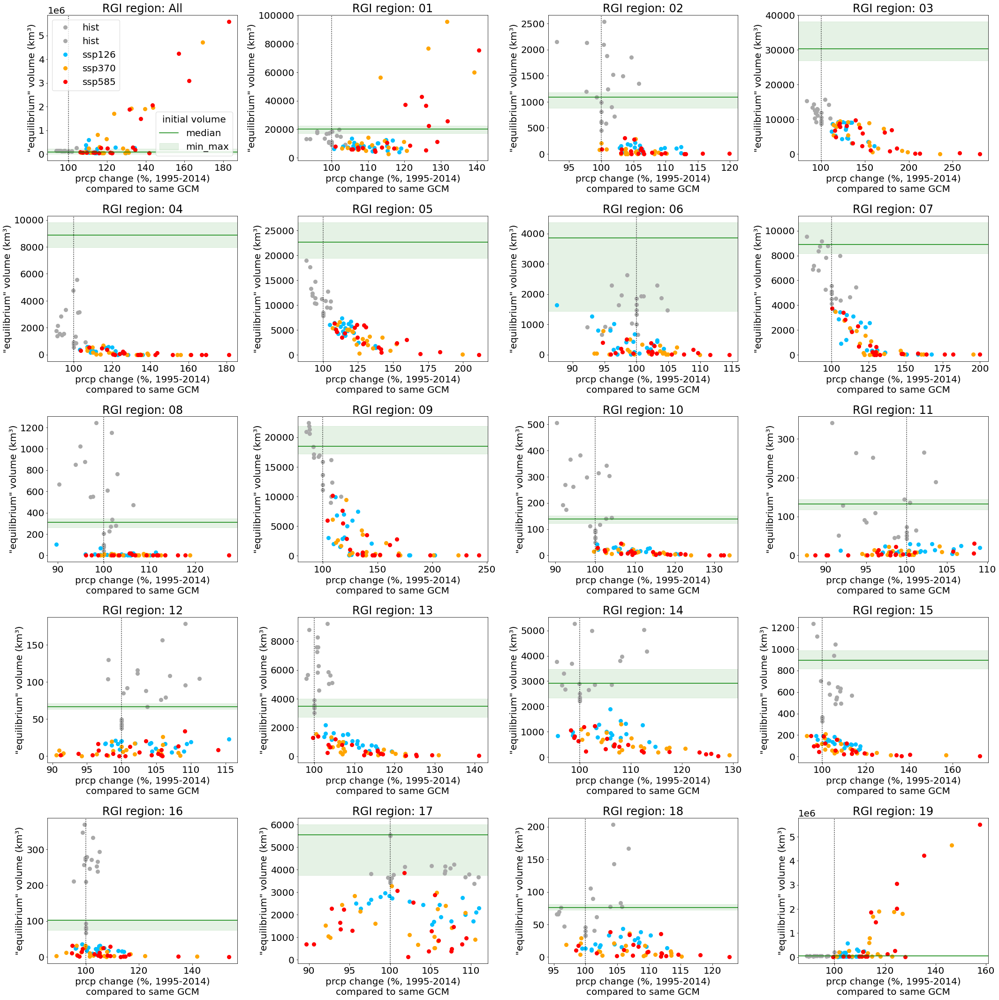

In [67]:
#ssp_colors = sns.color_palette(['silver', 'deepskyblue', 'orange', 'red'])
#     plt.plot(ds_regional_filled_sel.deltaT.transpose('gcm', 'ssp', 'period').sel(ssp =ssp),
plt.rcParams.update({'font.size': 20})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']
fig, axs = plt.subplots(5,4,figsize=(30,30))

rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19']
for j, rgi_reg in enumerate(rgi_regs_global):
    if j<4:
        ax = axs[0][j]
    elif j <8:
        ax = axs[1][j-4]
    elif j <12:
        ax = axs[2][j-8]
    elif j <16:
        ax = axs[3][j-12]
    elif j <20:
        ax = axs[4][j-16]
        
    for c,ssp in zip(ssp_colors, ds_regional_filled.ssp.values):
        ax.plot(ds_regional_filled['prcp change (%) to same GCM'].sel(ssp =ssp, rgi_reg=rgi_reg),
                 ds_regional_filled.volume_m3.sel(simulation_year=5000, rgi_reg=rgi_reg, ssp=ssp).squeeze()/1e9,
                 marker='o',markersize=8, lw=0, color=c, label = ssp)
    handles, labels = ax.get_legend_handles_labels()
    if j == 0:
        leg1 = ax.legend(handles[::7], labels[::7])
    ax.axhline(ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median()/1e9, color='green', label='median')
    ax.axhspan(ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).min()/1e9,
                ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).max()/1e9, alpha =0.1, color = 'green', label='min_max')
    handles, labels = ax.get_legend_handles_labels()
    if j == 0:
        ax.legend([handles[-2], handles[-1]], ['median', labels[-1]], title='initial volume', loc = 'lower right')
        ax.add_artist(leg1)
    ax.set_ylabel('"equilibrium" volume (km³)')
    ax.set_xlabel(f'prcp change (%, 1995-2014)\ncompared to same GCM')
    med_initial_vol = ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median().values/1e9
    initial_vol = f'median: {med_initial_vol:.2f}km3'
    ax.set_title(f'RGI region: {rgi_reg}')
    ax.axvline(100, ls=':', color='k')

plt.tight_layout()
plt.savefig(path_analysis + f'{model_author}_regional_glacier_vs_prcp_change_relative_to_ref_period_of_same_gcm.png')


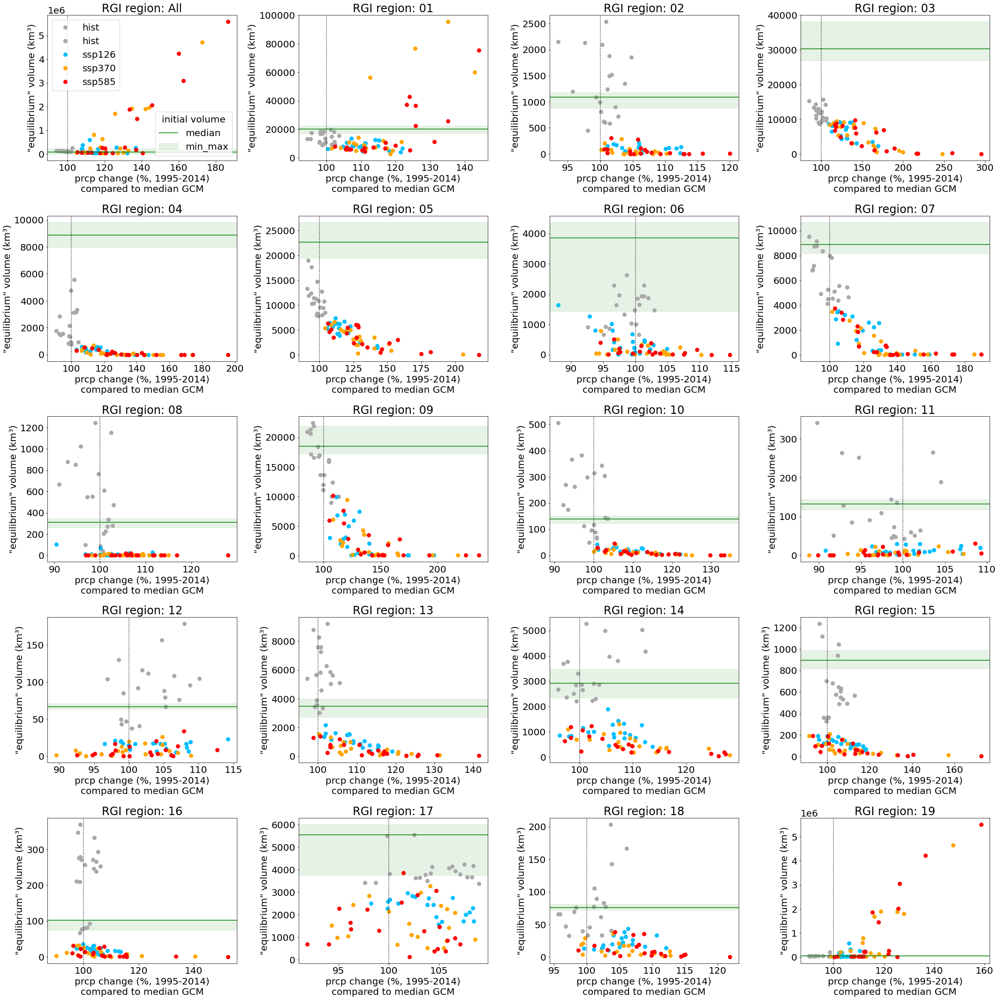

In [68]:
#ssp_colors = sns.color_palette(['silver', 'deepskyblue', 'orange', 'red'])
#     plt.plot(ds_regional_filled_sel.deltaT.transpose('gcm', 'ssp', 'period').sel(ssp =ssp),
plt.rcParams.update({'font.size': 20})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']
fig, axs = plt.subplots(5,4,figsize=(30,30))

rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19']
for j, rgi_reg in enumerate(rgi_regs_global):
    if j<4:
        ax = axs[0][j]
    elif j <8:
        ax = axs[1][j-4]
    elif j <12:
        ax = axs[2][j-8]
    elif j <16:
        ax = axs[3][j-12]
    elif j <20:
        ax = axs[4][j-16]
        
    for c,ssp in zip(ssp_colors, ds_regional_filled.ssp.values):
        ax.plot(ds_regional_filled['prcp change (%) to median GCM'].sel(ssp =ssp, rgi_reg=rgi_reg),
                 ds_regional_filled.volume_m3.sel(simulation_year=5000, rgi_reg=rgi_reg, ssp=ssp).squeeze()/1e9,
                 marker='o',markersize=8, lw=0, color=c, label = ssp)
    handles, labels = ax.get_legend_handles_labels()
    if j == 0:
        leg1 = ax.legend(handles[::7], labels[::7])
    ax.axhline(ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median()/1e9, color='green', label='median')
    ax.axhspan(ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).min()/1e9,
                ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).max()/1e9, alpha =0.1, color = 'green', label='min_max')
    handles, labels = ax.get_legend_handles_labels()
    if j == 0:
        ax.legend([handles[-2], handles[-1]], ['median', labels[-1]], title='initial volume', loc = 'lower right')
        ax.add_artist(leg1)
    ax.set_ylabel('"equilibrium" volume (km³)')
    ax.set_xlabel(f'prcp change (%, 1995-2014)\ncompared to median GCM')
    med_initial_vol = ds_regional_filled.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median().values/1e9
    initial_vol = f'median: {med_initial_vol:.2f}km3'
    ax.set_title(f'RGI region: {rgi_reg}')
    ax.axvline(100, ls=':', color='k')

plt.tight_layout()
plt.savefig(path_analysis + f'{model_author}_regional_glacier_vs_prcp_change_relative_to_ref_period_of_median_gcm.png')


In [171]:
ds_regional_filled

<xarray.Dataset>
Dimensions:                               (model_author: 1, simulation_year: 5001, period: 7, gcm: 5, ssp: 4, rgi_reg: 20)
Coordinates:
  * model_author                          (model_author) object 'Rounce'
  * simulation_year                       (simulation_year) int16 0 1 ... 5000
  * period                                (period) object '1851-1870' ... '20...
  * gcm                                   (gcm) object 'gfdl-esm4' ... 'ukesm...
  * ssp                                   (ssp) object 'hist' ... 'ssp585'
  * rgi_reg                               (rgi_reg) object '01' '02' ... 'All'
Data variables:
    volume_m3                             (model_author, gcm, ssp, period, rgi_reg, simulation_year) float64 ...
    area_m2                               (model_author, gcm, ssp, period, rgi_reg, simulation_year) float64 ...
    ratio_area_missing_filled_vs_working  (rgi_reg, period, gcm, ssp) float64 ...
    n_glaciers_missing_filled             (rgi_reg, period, gcm, ssp) float64 ...
    deltaT                                (gcm, ssp, period, rgi_reg) float64 ...
    prcp change (%)                       (gcm, ssp, period, rgi_reg) float64 ...
    deltaT per deltaGMT                   (gcm, ssp, period, rgi_reg) float64 ...
Attributes:
    contributor:                           Rounce
    contributor_email:                     drounce@cmu.edu
    creation_date:                         20/07/2022
    rgi-region:                            rgi01
    aggregation-level:                     sum
    period:                                1851-1870
    gcm:                                   gfdl-esm4
    ssp:                                   hist
    information:                           PyGEM for mass balance and calibra...
    stop_criterion:                        Simulations were stopped if volume...
    ratio_area_missing_filled_vs_working:  0.0019518900486568797
    n_glaciers_missing_filled:             18

In [ ]:
pd_reg_models_count = ds_reg_models.volume_m3.sel(simulation_year=0).to_dataframe().groupby(['rgi_reg', 'model_author'])['volume_m3'].count().reset_index()
pd_reg_models_count = pd_reg_models_count.loc[pd_reg_models_count.rgi_reg !='All']
pd_reg_models_count = pd_reg_models_count.rename(columns={'volume_m3':'n_experiments'})
# models available for each region...
_regional_model = pd_reg_models_count.loc[pd_reg_models_count.n_experiments == 80]

## amount of models per region
reg_n_models = pd_reg_models_count.loc[pd_reg_models_count.n_experiments == 80].groupby('rgi_reg').count()['model_author']
# models that are globally available 
global_models = pd_reg_models_count.groupby('model_author').sum().where(pd_reg_models_count.groupby('model_author').sum() == 80 * 19).dropna().index

# color blind seaborn palette, but want the two Rounce types w. similar color
pal_models = [(0.33725490196078434, 0.7058823529411765, 0.9137254901960784),
               (0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
               (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8, 0.47058823529411764, 0.7372549019607844)]
#pal_models = sns.color_palette(pal_models)
hue_order = ['Rounce', 'Huss','Compagno', 'Kraaijenbrink',
       'GLIMB']

#ssp_colors = sns.color_palette(['silver', 'deepskyblue', 'orange', 'red'])
#     plt.plot(ds_regional_filled_sel.deltaT.transpose('gcm', 'ssp', 'period').sel(ssp =ssp),
plt.rcParams.update({'font.size': 18})

ssp_colors = ['darkgrey', 'deepskyblue', 'orange', 'red']

for sim_year in [2000,5000]:
    fig, axs = plt.subplots(5,4,figsize=(30,30))
    rgi_regs_global = ['All','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12',
           '13', '14', '15', '16', '17', '18', '19']
    for j, rgi_reg in enumerate(rgi_regs_global):
        if j<4:
            ax = axs[0][j]
        elif j <8:
            ax = axs[1][j-4]
        elif j <12:
            ax = axs[2][j-8]
        elif j <16:
            ax = axs[3][j-12]
        elif j <20:
            ax = axs[4][j-16]
        if rgi_reg == 'All':
            # only take models that exist globally
            # at the moment Rounce and Glimb, Compagno
            n = len(global_models)
            for c,m in zip(pal_models, hue_order):
                if m in global_models:
                    ax.plot(ds_reg_models['deltaT to median GCM'].sel(rgi_reg=rgi_reg).values.flatten(),
                         ds_reg_models.volume_m3.sel(simulation_year=sim_year, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9,
                         marker='o',markersize=8, lw=0, color=c, label = m)
                else:
                    pass

        else:    
            models_available = _regional_model.loc[_regional_model.rgi_reg==rgi_reg]['model_author'].values
            n = reg_n_models[rgi_reg]

            for c,m in zip(pal_models, hue_order):
                if m in models_available:
                    ax.plot(ds_reg_models['deltaT to median GCM'].sel(rgi_reg=rgi_reg).values.flatten(),
                             ds_reg_models.volume_m3.sel(simulation_year=5000, model_author=m, rgi_reg=rgi_reg).values.flatten()/1e9,
                             marker='o',markersize=8, lw=0, color=c, label = m)

        handles, labels = ax.get_legend_handles_labels()
        #if j == 0 or j ==1:
        leg1 = ax.legend(handles[:6], labels[:6], title ='available models') #, loc='upper left')
        for c,m in zip(pal_models, ds_reg_models.model_author):
            ax.axhline(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).median()/1e9, color=c, label='median')
            ax.axhspan(ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).min()/1e9,
                        ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg,model_author=m).max()/1e9, alpha =0.1, color =c, label='min_max')
        handles, labels = ax.get_legend_handles_labels()
        if j == 0:
            if sim_year <3000:
                loc = 'center right'
                boxi = (1,0.4)
            else:
                loc = 'center left'
                boxi = (0,0.4)
            ax.legend([handles[-12], handles[-6]], ['median', 'min_max'], title='initial volume', loc = loc, bbox_to_anchor=boxi)
            ax.add_artist(leg1)
        ax.set_ylabel(f'volume after {sim_year}yrs (km³)')

        ax.set_xlabel(f'$\Delta$T (compared to median GCM 1995-2014)')
        med_initial_vol = ds_reg_models.volume_m3.sel(simulation_year=0, rgi_reg=rgi_reg).median().values/1e9
        initial_vol = f'median: {med_initial_vol:.2f}km3'
        ax.set_title(f'RGI region: {rgi_reg} (n={n} models)')
        ax.axvline(0, ls=':', color='k')

    plt.tight_layout()

    plt.savefig(path_analysis + f'GlacierMIP3_5models_regional_glacier_{sim_year}yrs_vs_regional_temperature_change_rel_to_ref_period_of_median_gcm_SIMPLE.png')